## Importing Libraries

In [ ]:
import tensorflow as tf
import numpy as np
import openpifpaf
import torch

import os
os.environ['CUDA_VISIBLE_DEVICES']=''


from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Layer, InputSpec
from tensorflow.keras.layers import BatchNormalization
#BatchNormalization._USE_V2_BEHAVIOR = False
from keras.layers import Lambda

import openpifpaf


## Loading Weights

In [ ]:
net_cpu, _ = openpifpaf.network.factory(checkpoint='shufflenetv2k16w')
net = net_cpu.to('cpu')
arr = []
for name, param in net.base_net.named_parameters():
    if param.requires_grad:
        arr.append(param.data)


states = net.base_net.state_dict()

state_dict = []
for i in states.keys():
    state_dict.append(i)

stated = []
for i in state_dict:
    if len(states[i].shape)==4:
        stated.append(np.transpose(states[i].numpy(), (2,3,1,0)))
    else:
        stated.append(states[i].numpy())

state_dict[:10]

head_states = net.head_nets.state_dict()

head_stated = []
for i in net.head_nets.state_dict():
    if len(head_states[i].shape)==4:
        head_stated.append(np.transpose(head_states[i].numpy(), (2,3,1,0)))
    else:
        head_stated.append(head_states[i].numpy())

## Shufflenet

## Model Creation

In [ ]:
class BatchNorm(Layer):
    '''
        Batch Normalization (Layer)
    '''
    def __init__(self, weight,bias, mean, var):
        
        # Calling Parent
        super(BatchNorm, self).__init__()
        

        self.bn = tf.keras.layers.BatchNormalization(
                axis=-1, momentum=0.01, epsilon=0.0001, center=True, scale=True,
                beta_initializer=tf.constant_initializer(bias), gamma_initializer=tf.constant_initializer(weight),
                moving_mean_initializer=tf.constant_initializer(mean),
                moving_variance_initializer=tf.constant_initializer(var), renorm_momentum=0.99,trainable=False
            )

    @tf.function
    def call(self, inputs, training = True):
        return self.bn(inputs, training=training)
class Convolution2D(Layer):
    '''
        2D Convolution
    '''
    def __init__(self, filters, kernel_size, strides, padding, dilation_rate=1, weight = None, use_bias = False):
        super(Convolution2D, self).__init__()
        self.conv = tf.keras.layers.Conv2D(filters = filters, kernel_size = kernel_size,  strides = strides, use_bias = use_bias,
                        padding = "SAME", dilation_rate = dilation_rate, data_format="channels_last")

        input_shape = tf.TensorShape([kernel_size, kernel_size , 1, weight.shape[2]]) 
        self.conv.build(input_shape)
        self.conv.set_weights([weight])
        

        
        
        
    @tf.function
    def call(self, inputs):
        return self.conv(inputs)
class GroupConv2D(Layer):
    '''
    Depthwise Convolution
    '''
    def __init__(self, in_channels, groups, kernel_size = 1, stride = 2, weight = None, padding = "VALID"):
        super(GroupConv2D, self).__init__()
        self.group = groups
        self.dconv = tf.keras.layers.DepthwiseConv2D(kernel_size, strides=stride,
                                     depth_multiplier=in_channels//groups,
                                     padding=padding, use_bias=False,
                                     data_format = "channels_last" )
        
        
        weight = np.transpose(weight, (0,1,3,2))
        input_shape = tf.TensorShape([kernel_size, kernel_size , 1, weight.shape[2]]) 
        self.dconv.build(input_shape)
        self.dconv.set_weights([weight])
        
    
    @tf.function
    def call(self, inputs):
    
        vout = self.dconv(inputs)
        return vout 
class ReshapeTranspose(Layer):
    '''
        Reshape and Transpose Block
    '''
    def __init__(self):
        super(ReshapeTranspose, self).__init__()
    def call(self, inputs, training=False):
        x=tf.reshape(inputs[0],[inputs.shape[1],inputs.shape[2],2, inputs.shape[-1]//2])
        x=tf.expand_dims(x,axis=0)
        #x = tf.reshape(inputs, [-1, inputs.shape[1],  inputs.shape[2], 2, inputs.shape[-1]//2])
        #x = tf.transpose(x, perm=[0, 1, 2, 4, 3])
        x=tf.transpose(x[0],perm=[0,1,3,2])
        x=tf.expand_dims(x,axis=0)
        x = tf.reshape(x, [-1, inputs.shape[1], inputs.shape[2], inputs.shape[-1]])
        return x
class Shufflenet2k(Model):
    '''
        Shufflenet Starter Head, made using netron
        structure of the exported onnx model
    '''
    def __init__(self):
        super(Shufflenet2k, self).__init__()
        ind_states = 0
        self.reshape = ReshapeTranspose()
        self.act = tf.keras.layers.ReLU(max_value=None, negative_slope=0, threshold=0)
        self.conv1 = Convolution2D(filters = 24, kernel_size = 3, strides = 2, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn1   = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states+6
        
        #. -----------------------------------------------------------------------------------------------------------------------------
         #. --------------------------------------------------------------------------------------------------
        
        self.s2_0_branch1_conv1  = GroupConv2D(kernel_size = 3,  weight= stated[ind_states],  stride = 2, in_channels = 24, groups = 24,  padding = "SAME")
        self.bn_s2_0_branch1_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6

        
        
        self.s2_0_branch1_conv2   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_0_branch1_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
    
        #. --------------------------------------------------------------------------------------------------
        
        
        self.s2_0_branch2_conv1 =   Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_0_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_0_branch2_conv2  =   GroupConv2D(kernel_size = 3,  weight= stated[ind_states],  stride = 2, in_channels = 174, groups = 174,  padding = "SAME")
        self.bn_s2_0_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_0_branch2_conv3  =   Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_0_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
# #         #-------------------------------------------------------------------------------------------------------------------------------------
# #reshape transpose
        
        self.s2_1_branch2_conv1   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_1_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_1_branch2_conv2   =  GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 174,groups = 174,  padding = "SAME")
        self.bn_s2_1_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_1_branch2_conv3   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_1_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #-----------------------------------------------------------------------------------------------------------------------------
        
        
        self.s2_2_branch2_conv1   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_2_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
        self.s2_2_branch2_conv2   =  GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 174,groups = 174,  padding = "SAME")
        self.bn_s2_2_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_2_branch2_conv3   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_2_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #-----------------------------------------------------------------------------------------------------------------------------
        
        self.s2_3_branch2_conv1   = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_3_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_3_branch2_conv2  = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 174,groups = 174,  padding = "SAME")
        self.bn_s2_3_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s2_3_branch2_conv3  = Convolution2D(filters = 174, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s2_3_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
# #         #-----------------------------------------------------------------------------------------------------------------------------
# #         #. ---------------------------------------------------------------------------------------------------------------

        self.s3_0_branch1_conv1  = GroupConv2D(kernel_size = 3,  weight= stated[ind_states],  stride = 2, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_0_branch1_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_0_branch1_conv2  =  Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_0_branch1_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s3_0_branch2_conv1  = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_0_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_0_branch2_conv2  = GroupConv2D(kernel_size = 3,  weight= stated[ind_states],  stride = 2, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_0_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_0_branch2_conv3  = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_0_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        
        self.s3_1_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_1_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
        self.s3_1_branch2_conv2  = GroupConv2D(kernel_size = 5,  weight=stated[ind_states],  stride = 1, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_1_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_1_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_1_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s3_2_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_2_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_2_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_2_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_2_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_2_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        self.s3_3_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_3_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_3_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight=stated[ind_states],  stride = 1, in_channels = 348, groups = 348,  padding = "SAME")
        self.bn_s3_3_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_3_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_3_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        self.s3_4_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_4_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_4_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_4_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_4_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_4_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s3_5_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_5_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_5_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_5_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_5_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_5_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s3_6_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_6_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_6_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 348, groups = 348,  padding = "SAME")
        self.bn_s3_6_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_6_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_6_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s3_7_branch2_conv1 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_7_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_7_branch2_conv2 = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 348,groups = 348,  padding = "SAME")
        self.bn_s3_7_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s3_7_branch2_conv3 = Convolution2D(filters = 348, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s3_7_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s4_0_branch1_conv1  = GroupConv2D(kernel_size = 3,  weight=stated[ind_states],  stride = 2, in_channels = 696, groups = 696,  padding = "SAME")
        self.bn_s4_0_branch1_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_0_branch1_conv2  =  Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight= stated[ind_states] , use_bias = False)
        self.bn_s4_0_branch1_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s4_0_branch2_conv1  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_0_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_0_branch2_conv2  = GroupConv2D(kernel_size = 3,  weight= stated[ind_states],  stride = 2, in_channels = 696, groups = 696,  padding = "SAME")
        self.bn_s4_0_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_0_branch2_conv3  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_0_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s4_1_branch2_conv1  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_1_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_1_branch2_conv2  = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 696,groups = 696,  padding = "SAME")
        self.bn_s4_1_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_1_branch2_conv3  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_1_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#         #. --------------------------------------------------------------------------------------------------------------
        
        self.s4_2_branch2_conv1  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_2_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_2_branch2_conv2  = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 696, groups = 696,  padding = "SAME")
        self.bn_s4_2_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_2_branch2_conv3  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_2_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#          #. --------------------------------------------------------------------------------------------------------------
        
        self.s4_3_branch2_conv1  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_3_branch2_conv1 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
        self.s4_3_branch2_conv2  = GroupConv2D(kernel_size = 5,  weight= stated[ind_states],  stride = 1, in_channels = 696,groups = 696,  padding = "SAME")
        self.bn_s4_3_branch2_conv2 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        self.s4_3_branch2_conv3  = Convolution2D(filters = 696, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s4_3_branch2_conv3 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        
#         #. --------------------------------------------------------------------------------------------------------------
#         #-----------------------------------------------------------------------------------------------------------------------------
#          #. --------------------------------------------------------------------------------------------------------------
        
        self.s5  = Convolution2D(filters = 1392, kernel_size = 1, strides = 1, padding = 'VALID',dilation_rate = 1,weight=stated[ind_states], use_bias = False)
        self.bn_s5 = BatchNorm(stated[ind_states+1],stated[ind_states+2],stated[ind_states+3],stated[ind_states+4] )
        ind_states = ind_states + 6
        
        print(ind_states)
        
        #. --------------------------------------------------------------------------------------------------------------
        #-----------------------------------------------------------------------------------------------------------------------------
        
        
    def call(self, inputs, training=True):
        
        # Initial Convolution
        
        x = self.conv1(inputs)
        x = self.bn1(x)   
        x = self.act(x)
    #    -----------------    -----------------    -----------------  First Block   -----------------    -----------------    -----------------  
        y = x
        x = self.s2_0_branch1_conv1(x)
        x = self.bn_s2_0_branch1_conv1(x) 
        x = self.s2_0_branch1_conv2(x)   
        x = self.bn_s2_0_branch1_conv2(x)
        x = self.act(x)
        z = x
        
        x = self.s2_0_branch2_conv1(y)   # Y
        x = self.bn_s2_0_branch2_conv1(x)
        x = self.act(x)
        x = self.s2_0_branch2_conv2(x)  
        x = self.bn_s2_0_branch2_conv2(x)
        x = self.s2_0_branch2_conv3(x)
        x = self.bn_s2_0_branch2_conv3(x)
        x = self.act(x)
        
        x = tf.concat([z , x], axis=-1)
        x = self.reshape(x)
   #    -----------------    -----------------    -----------------  Second Block  -----------------    -----------------    -----------------     
          #Saving for skip connection
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s2_1_branch2_conv1(x) 
        x = self.bn_s2_1_branch2_conv1(x)
        x = self.act(x)
        x = self.s2_1_branch2_conv2(x)   
        x = self.bn_s2_1_branch2_conv2(x)
        x = self.s2_1_branch2_conv3(x)
        x = self.bn_s2_1_branch2_conv3(x)
        x = self.act(x)
        
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
   # -----------------    -----------------    -----------------  Third Block  -----------------    -----------------    -----------------    
        
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)   #Saving for skip connection
        
        x = self.s2_2_branch2_conv1(x)   
        x = self.bn_s2_2_branch2_conv1(x)
        x = self.act(x)
        x = self.s2_2_branch2_conv2(x)   
        x = self.bn_s2_2_branch2_conv2(x)
        x = self.s2_2_branch2_conv3(x)   
        x = self.bn_s2_2_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
    #    -----------------    -----------------    ----------------- Fourth Block  -----------------    -----------------    -----------------
    
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s2_3_branch2_conv1(x)
        x = self.bn_s2_3_branch2_conv1(x)
        x = self.act(x)
        x = self.s2_3_branch2_conv2(x)
        x = self.bn_s2_3_branch2_conv2(x)
        x = self.s2_3_branch2_conv3(x)
        x = self.bn_s2_3_branch2_conv3(x)
        x = self.act(x)
        
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
    #    -----------------    -----------------    ----------------- Fifth Block  -----------------    -----------------    -----------------
        
        y = x
        
        x = self.s3_0_branch1_conv1(x)    
        x = self.bn_s3_0_branch1_conv1(x)
        x = self.s3_0_branch1_conv2(x)  
        x = self.bn_s3_0_branch1_conv2(x)
        x = self.act(x)
        z = x
        
        x = self.s3_0_branch2_conv1(y)   #Y
        x = self.bn_s3_0_branch2_conv1(x)
        x = self.act(x)
        x = self.s3_0_branch2_conv2(x)  
        x = self.bn_s3_0_branch2_conv2(x)
        x = self.s3_0_branch2_conv3(x) 
        x = self.bn_s3_0_branch2_conv3(x)
        x = self.act(x)
        
        x = tf.concat([z , x], axis=-1)
        x = self.reshape(x)
        
#    -----------------    -----------------    ----------------- Sixth Block  -----------------    -----------------    -----------------
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
    
        x = self.s3_1_branch2_conv1(x)  
        x = self.bn_s3_1_branch2_conv1(x)
        x = self.act(x)
        x = self.s3_1_branch2_conv2(x) 
        x = self.bn_s3_1_branch2_conv2(x)
        x = self.s3_1_branch2_conv3(x)  
        x = self.bn_s3_1_branch2_conv3(x)
        x = self.act(x)
        
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Seventh Block  -----------------    -----------------    -----------------
        
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s3_2_branch2_conv1(x)  
        x = self.bn_s3_2_branch2_conv1(x)
        x = self.act(x)
        x = self.s3_2_branch2_conv2(x)  
        x = self.bn_s3_2_branch2_conv2(x)
        x = self.s3_2_branch2_conv3(x)  
        x = self.bn_s3_2_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Eight Block  -----------------    -----------------    -----------------
        
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s3_3_branch2_conv1(x)  
        x = self.bn_s3_3_branch2_conv1(x)
        x = self.act(x)
        x = self.s3_3_branch2_conv2(x)  
        x = self.bn_s3_3_branch2_conv2(x)
        x = self.s3_3_branch2_conv3(x)  
        x = self.bn_s3_3_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        #return x
        
#   -----------------    -----------------    ----------------- Ninth Block  -----------------    -----------------    -----------------
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s3_4_branch2_conv1(x)  
        x = self.bn_s3_4_branch2_conv1(x)  
        x = self.act(x)
        x = self.s3_4_branch2_conv2(x)    
        x = self.bn_s3_4_branch2_conv2(x)  
        x = self.s3_4_branch2_conv3(x)    
        x = self.bn_s3_4_branch2_conv3(x)  
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
 #   -----------------    -----------------    ----------------- Tenth Block  -----------------    -----------------    -----------------
        
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s3_5_branch2_conv1(x)    
        x = self.bn_s3_5_branch2_conv1(x)  
        x = self.act(x)
        x = self.s3_5_branch2_conv2(x)    
        x = self.bn_s3_5_branch2_conv2(x)  
        x = self.s3_5_branch2_conv3(x)    
        x = self.bn_s3_5_branch2_conv3(x)  
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Eleven Block  -----------------    -----------------    -----------------
           
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        x = self.s3_6_branch2_conv1(x)  
        x = self.bn_s3_6_branch2_conv1(x)  
        x = self.act(x)
        x = self.s3_6_branch2_conv2(x)    
        x = self.bn_s3_6_branch2_conv2(x)  
        x = self.s3_6_branch2_conv3(x)    
        x = self.bn_s3_6_branch2_conv3(x)  
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Twelve Block  -----------------    -----------------    -----------------
      
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s3_7_branch2_conv1(x)    
        x = self.bn_s3_7_branch2_conv1(x)  
        x = self.act(x)
        x = self.s3_7_branch2_conv2(x)    
        x = self.bn_s3_7_branch2_conv2(x)  
        x = self.s3_7_branch2_conv3(x)    
        x = self.bn_s3_7_branch2_conv3(x)  
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
 #   -----------------    -----------------    ----------------- Thirteen Block  -----------------    -----------------    -----------------
         
        y = x
        
        x = self.s4_0_branch1_conv1(x)  
        x = self.bn_s4_0_branch1_conv1(x)
        x = self.s4_0_branch1_conv2(x)  
        x = self.bn_s4_0_branch1_conv2(x)
        x = self.act(x)
        z = x
        x = self.s4_0_branch2_conv1(y)  
        x = self.bn_s4_0_branch2_conv1(x)
        x = self.act(x)
        x = self.s4_0_branch2_conv2(x)  
        x = self.bn_s4_0_branch2_conv2(x)
        x = self.s4_0_branch2_conv3(x)  
        x = self.bn_s4_0_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([z , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Fourteen Block  -----------------    -----------------    -----------------
             
    
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s4_1_branch2_conv1(x) 
        x = self.bn_s4_1_branch2_conv1(x)
        x = self.act(x)
        x = self.s4_1_branch2_conv2(x)  
        x = self.bn_s4_1_branch2_conv2(x)
        x = self.s4_1_branch2_conv3(x)  
        x = self.bn_s4_1_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Fourteen Block  -----------------    -----------------    -----------------
        
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s4_2_branch2_conv1(x)  
        x = self.bn_s4_2_branch2_conv1(x)
        x = self.act(x)
        x = self.s4_2_branch2_conv2(x)  
        x = self.bn_s4_2_branch2_conv2(x)
        x = self.s4_2_branch2_conv3(x)  
        x = self.bn_s4_2_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
        
#   -----------------    -----------------    ----------------- Fourteen Block  -----------------    -----------------    -----------------       
        
    
        x0, x = tf.split( x, [x.shape[-1]//2, x.shape[-1]//2], axis=3)
        
        x = self.s4_3_branch2_conv1(x) 
        x = self.bn_s4_3_branch2_conv1(x)
        x = self.act(x)
        x = self.s4_3_branch2_conv2(x)  
        x = self.bn_s4_3_branch2_conv2(x)
        x = self.s4_3_branch2_conv3(x)  
        x = self.bn_s4_3_branch2_conv3(x)
        x = self.act(x)
        x = tf.concat([x0 , x], axis=-1)
        x = self.reshape(x)
#         return x
 #   -----------------    -----------------    ----------------- Fourteen Block  -----------------    -----------------    -----------------       
        
           
        
        x = self.s5(x)   
        x = self.bn_s5(x) 
        x = self.act(x)

        
        return x
map_s = 49
class CIF(Model):
    def __init__(self):
        super(CIF, self).__init__()
        self.conv  = tf.keras.layers.Conv2D(340, kernel_size=1, strides=(1, 1), padding='valid',  dilation_rate=(1, 1), use_bias=True,kernel_initializer='glorot_uniform')
        self.reshape = ReshapeTranspose()
        
#         print(" Loading Normal Conv Weights shape ", head_stated[0].shape)
        input_shape = tf.TensorShape([1, 1 , head_stated[0].shape[3], head_stated[0].shape[2]]) 
        self.conv.build(input_shape)
        self.conv.set_weights([head_stated[0], head_stated[1]])
#         print(" Weights Loaded")
        self.ex=tf.keras.backend.exp
        self.sig=tf.math.sigmoid
    
    @tf.function    
    def call(self, inputs, training=False):
        x = inputs
        x = self.conv(x)
        #x = self.reshape(x)
        

        x=tf.transpose(x,perm=[0,3,1,2])
        upscale_factor = 2
        x = tf.squeeze(x, axis=0)
        channels = x.shape[0]
        height = x.shape[1]
        width = x.shape[2]
        
        t11 = tf.reshape(x, (int(channels/upscale_factor**2), upscale_factor, upscale_factor ,height*width)) # (3,2, 2, 4)
        t12 = tf.transpose(t11, (0, 1, 3, 2 ))
        t12 = tf.reshape(t12, ( int(channels/upscale_factor**2), upscale_factor, height, width, upscale_factor)) #(3, 2, 2,2, 2)
        t13 = tf.reshape(t12, (int(channels/upscale_factor**2), upscale_factor, height, width*upscale_factor))
        t12 = tf.transpose(t13, (0, 2, 1, 3 ))
        t12 = tf.reshape(t12, (1,int(channels/upscale_factor**2), upscale_factor* height, width*upscale_factor))
        
        x = t12
        
#         x=tf.expand_dims(x,axis=0)
        
        x = x[:, :, :-1, :-1]
        
        classes_x = x[:, :17] 
        
        regs_x = x[:, 17:51]
        regs_logb = x[:, 51:68]
        scales_x = x[:,68:85]
        
        classes_x = self.sig(classes_x)
        scales_x = self.ex(scales_x)
        classes_x = tf.reshape(classes_x, [-1,17, 1, map_s, map_s])
        regs_x = tf.reshape(regs_x, [-1,17, 1, 2, map_s, map_s])
        regs_logb = tf.reshape(regs_logb, [-1,17, 1, map_s, map_s])
        scales_x = tf.reshape(scales_x, [-1,17, 1, map_s, map_s])

        
        return classes_x, regs_x, regs_logb, scales_x
class CAF(Model):
    '''
        Shufflenet Starter Head, made using netron
        structure of the exported onnx model
    '''
    
    
    def __init__(self):
        super(CAF, self).__init__()
        self.conv  = tf.keras.layers.Conv2D(
                                684, kernel_size=1, strides=(1, 1), padding='valid',  dilation_rate=(1, 1), use_bias=True,
                                kernel_initializer='glorot_uniform')
        

#         print(" Loading Normal Conv Weights shape ", head_stated[0].shape)
        input_shape = tf.TensorShape([1, 1 , 1, head_stated[0].shape[2]]) 
        self.conv.build(input_shape)
        self.conv.set_weights([head_stated[2], head_stated[3]])
        self.ex1=tf.keras.backend.exp
        self.sig1=tf.math.sigmoid
#         print(" Weights Loaded")
        
        self.reshape = ReshapeTranspose()
    
    @tf.function
    def call(self, inputs, training=True, debug=True):
        x = inputs
        x = self.conv(x)
        #x = self.reshape(x)
        x=tf.transpose(x,perm=[0,3,1,2])
        
#         print(x.shape)
        
        upscale_factor = 2
        x = tf.squeeze(x, axis=0)
        channels = x.shape[0]
        height = x.shape[1]
        width = x.shape[2]
        
        t11 = tf.reshape(x, (int(channels/upscale_factor**2), upscale_factor, upscale_factor ,height*width)) # (3,2, 2, 4)
        t12 = tf.transpose(t11, (0, 1, 3, 2 ))
        t12 = tf.reshape(t12, ( int(channels/upscale_factor**2), upscale_factor, height, width, upscale_factor)) #(3, 2, 2,2, 2)
        t13 = tf.reshape(t12, (int(channels/upscale_factor**2), upscale_factor, height, width*upscale_factor))
        t12 = tf.transpose(t13, (0, 2, 1, 3 ))
        t12 = tf.reshape(t12, (1,int(channels/upscale_factor**2), upscale_factor* height, width*upscale_factor))
        
        x = t12
        
        
        x = x[:, :, :-1, :-1]
        
        classes_x = x[:, :19]
        
        regs_x = x[:, 19:95]
        regs_logb = x[:, 95:133]
        scales_x = x[:,133:]
        
        classes_x = self.sig1(classes_x)
        scales_x = self.ex1(scales_x)
#         print('classes_x' , classes_x.shape)
        classes_x = tf.reshape(classes_x, [-1,19, 1, map_s ,map_s])
        regs_x = tf.reshape(regs_x, [-1,19, 2, 2, map_s, map_s])
        regs_logb = tf.reshape(regs_logb, [-1,19, 2, map_s, map_s])
        scales_x = tf.reshape(scales_x, [-1,19, 2, map_s, map_s])
#         print(classes_x.shape)
#         print("CIF")
#         print("Final Shapes")
#         print(classes_x.shape)
#         print(regs_x.shape)
#         print(regs_logb.shape)
#         print(scales_x.shape)
        
        
        return classes_x, regs_x, regs_logb, scales_x

class PIFPAF(Model):
    def __init__(self):
        super(PIFPAF, self).__init__()
        self.shuffle=Shufflenet2k()
        self.cif=CIF()
        self.caf=CAF()
    @tf.function
    def fun(self,img,mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225]):
        im=img/255
        im=tf.transpose(im,perm=[2,0,1])
        arr=[]
        for i in range(3):
            arr.append((im[i]-mean[i])/std[i])
        arr=tf.convert_to_tensor(arr)
        arr=tf.transpose(arr,perm=[1,2,0])
        arr=tf.expand_dims(arr,0)
        
        return arr
    @tf.function
    def func(self,output):
        out_py=output
        tt = []
        for j in out_py:
            temp1 =[]
            for i in j:
                if len(i.shape)==6:
                    if i.shape[1]==17:
                        #i=tf.squeeze(i,axis=0)
                        i = tf.reshape(i,[1,17,2,map_s,map_s])
                        #i=tf.expand_dims(i,axis=0)
                    if i.shape[1]==19:
                        #i=tf.squeeze(i,axis=0)
                        i = tf.reshape(i,[1,19,4,map_s,map_s])
                        #i=tf.expand_dims(i,axis=0)
#                     i = tf.reshape(i,(-1,i.shape[1],i.shape[2]*i.shape[3],i.shape[4],i.shape[5]))
                temp1.append(i)
            tt.append(temp1)
        cif_c = tf.concat([tt[0][0],tt[0][1],tt[0][2],tt[0][3]], axis=2)
        caf_c = tf.concat([tt[1][0],tt[1][1],tt[1][2],tt[1][3]], axis=2)
        val = []
        val2 = []
        for i in range(map_s):
            val.append(tf.range(0, map_s, 1, dtype=tf.float32))
            val2.append(tf.fill([map_s], float(i)))
        t = tf.stack([val, val2], axis=0)
        r = tf.expand_dims(t, 0)
        r = tf.expand_dims(r, 0)
        index_field = r
        a=cif_c[:, :, 1:3]
        a+=index_field
        cif_c=tf.concat([cif_c[:, :, 0:1],a,cif_c[:, :, 3:5]], axis=2)
        a=caf_c[:, :, 1:3]
        a+=index_field
        b=caf_c[:, :, 3:5]
        b+=index_field
        caf_c=tf.concat([caf_c[:, :, 0:1],a,b,caf_c[:, :, 5:9]],axis=2)
        tup=(1,2, 5, 7, 3, 4, 6, 8)
        a=caf_c[:,:,0:1]
        for i in tup:
            a=tf.concat([a,caf_c[:,:,i:i+1]],axis=2)
        caf_c=a
        final = [cif_c, caf_c]
        return final
    @tf.function
    def call(self,inputs,training=True):
        x=self.fun(inputs[0])
        x=self.shuffle(x,training)
        y =self.cif(x,training)
        z =self.caf(x,training)
        final=self.func([y,z])
        return final

## Inference (Image)

In [ ]:
import matplotlib
import requests
import PIL, io
import numpy as np
import os
os.environ['CUDA_VISIBLE_DEVICES']=''
import tensorflow as tf
from Decoder import CifCaf, KeypointPainter, image_canvas
# image_response = requests.get('https://previews.123rf.com/images/piksel/piksel1301/piksel130100090/17604593-casual-young-man-standing.jpg')
# image_response = requests.get('https://raw.githubusercontent.com/vita-epfl/openpifpaf/master/docs/coco/000000081988.jpg')
image_response = requests.get('https://www.telegraph.co.uk/content/dam/football/2017/03/08/JS122863774_Getty-Images-Europe_FC-Barcelona-v-Paris-Saint-Germain-UEFA-Champions-League-Round_trans_NvBQzQNjv4BqqVzuuqpFlyLIwiB6NTmJwZ_d2gJnLGFVBaEhcbHfaHk.jpg?imwidth=450')
# image_response = requests.get("https://media3.s-nbcnews.com/j/newscms/2018_17/2413576/b_dib_metzl1squat2_170213_40fb12f1c35eacbbde96cd69a7361022.fit-760w.jpg") 
pil_im = PIL.Image.open(io.BytesIO(image_response.content)).convert('RGB')
pil_im = pil_im.resize((385,385))
im = np.asarray(pil_im)

data1=np.expand_dims(im,axis=0)

# pifpaf7=PIFPAF()
pifpaf7 = tf.keras.models.load_model('../Models/Original_Models/Shufflenet/')
final=pifpaf7(data1.astype(np.float32),True)

heads = [[],[]]
heads[0] = final[0][0].numpy()
heads[1] = final[1][0].numpy()

keypoint_painter = KeypointPainter(color_connections=True, linewidth=6)

predictions = []

keypoints = ['nose', 'left_eye', 'right_eye', 'left_ear', 'right_ear', 'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow', 'left_wrist',
             'right_wrist', 'left_hip', 'right_hip', 'left_knee', 'right_knee', 'left_ankle', 'right_ankle']
skeleton = [(16, 14), (14, 12), (17, 15), (15, 13), (12, 13), (6, 12), (7, 13), (6, 7), (6, 8), (7, 9), (8, 10), (9, 11), (2, 3), (1, 2), (1, 3), (2, 4),
             (3, 5), (4, 6), (5, 7)]

decoder = CifCaf(keypoints=keypoints,skeleton=skeleton)
predictions = decoder.decode(heads)


import matplotlib
with image_canvas(data1[0]) as ax:
    keypoint_painter.annotations(ax, predictions)

## Inference (Video)

In [1]:
import PIL, io
from PIL import Image
import tensorflow as tf
import numpy as np
import os
os.environ['CUDA_VISIBLE_DEVICES']=''
import cv2
import matplotlib.pyplot as plt
import numpy as np

from Decoder import CifCaf, KeypointPainter, image_canvas

keypoints = ['nose', 'left_eye', 'right_eye', 'left_ear', 'right_ear', 'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow', 'left_wrist',
             'right_wrist', 'left_hip', 'right_hip', 'left_knee', 'right_knee', 'left_ankle', 'right_ankle']
skeleton = [(16, 14), (14, 12), (17, 15), (15, 13), (12, 13), (6, 12), (7, 13), (6, 7), (6, 8), (7, 9), (8, 10), (9, 11), (2, 3), (1, 2), (1, 3), (2, 4),
             (3, 5), (4, 6), (5, 7)]


Decoder init


In [2]:
# !youtube-dl https://youtu.be/ZH4BbR8Zi-A

In [ ]:
# mv testt.mp4 Videos/test.mkv

In [ ]:
# mv 20_MIN_FULL_BODY_WORKOUT_No_Equipment_Pamela_Reif-UBMk30rjy0o.webm Videos/test.mkv

In [4]:
VIDEO_FILE = 'Videos/test.mkv'
START_FRAME = 1200
CURRENT_FRAME = 0

In [6]:
import tensorflow as tf
# model = tf.keras.models.load_model('../Models/Original_Models/Shufflenet/')

decoder = CifCaf( keypoints=keypoints,skeleton=skeleton,out_skeleton=skeleton)
keypoint_painter = KeypointPainter(color_connections=True, linewidth=6)

cap = cv2.VideoCapture(VIDEO_FILE)
if (cap.isOpened()== False):
    print("Error opening video stream or file")
else:
    print('file opened')
    

file opened


In [7]:
tert = np.random.rand(2,385,385,3).astype(np.float32)
b = model(tert)

In [8]:
len(b), b[0].shape, b[1].shape

(2, TensorShape([1, 17, 5, 49, 49]), TensorShape([1, 19, 9, 49, 49]))

PREDICTIONS NONE


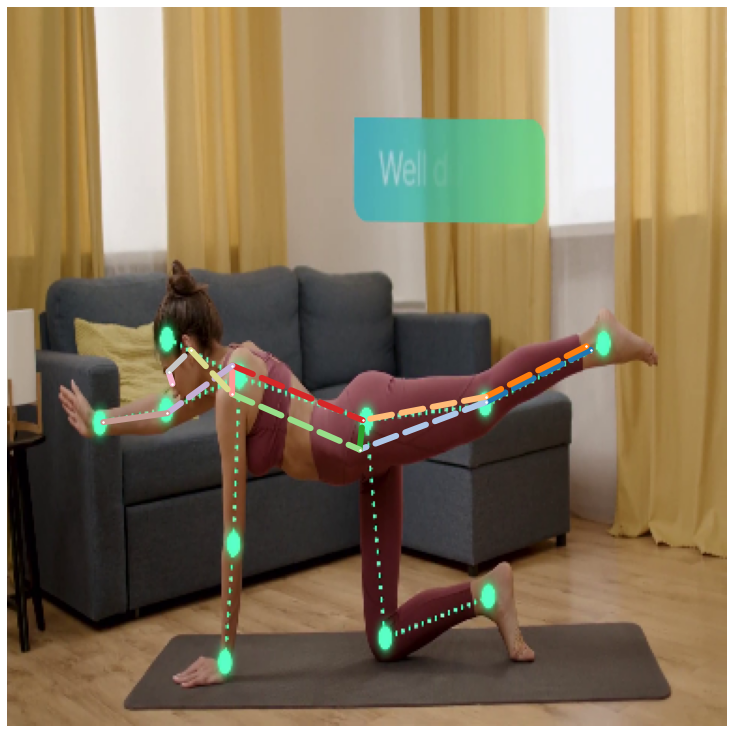

1203
PREDICTIONS NONE


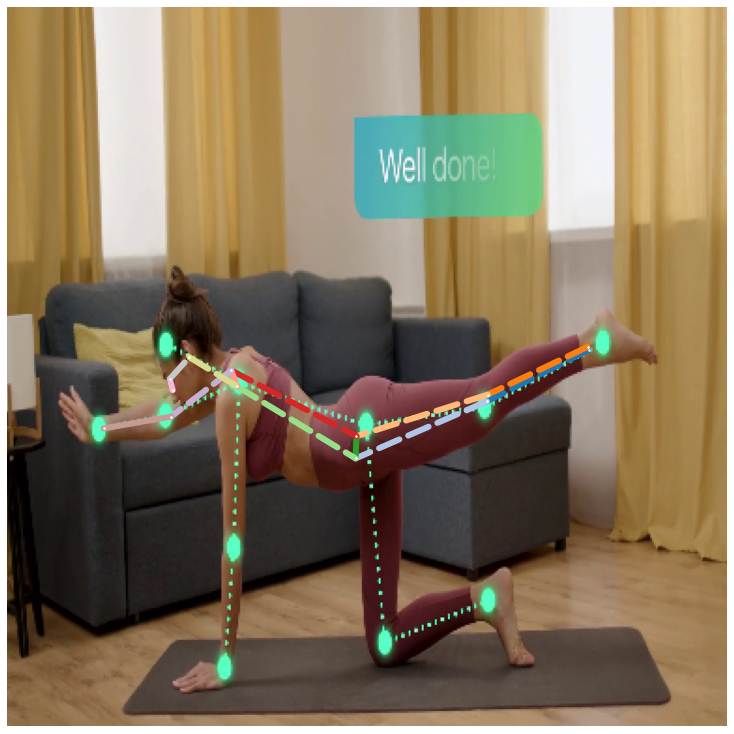

1206
PREDICTIONS NONE


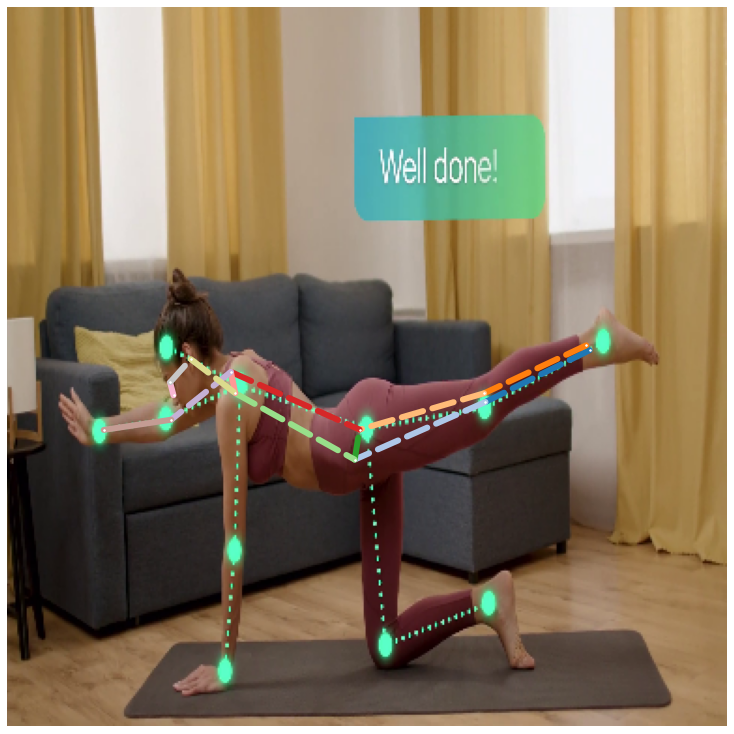

1209
PREDICTIONS NONE


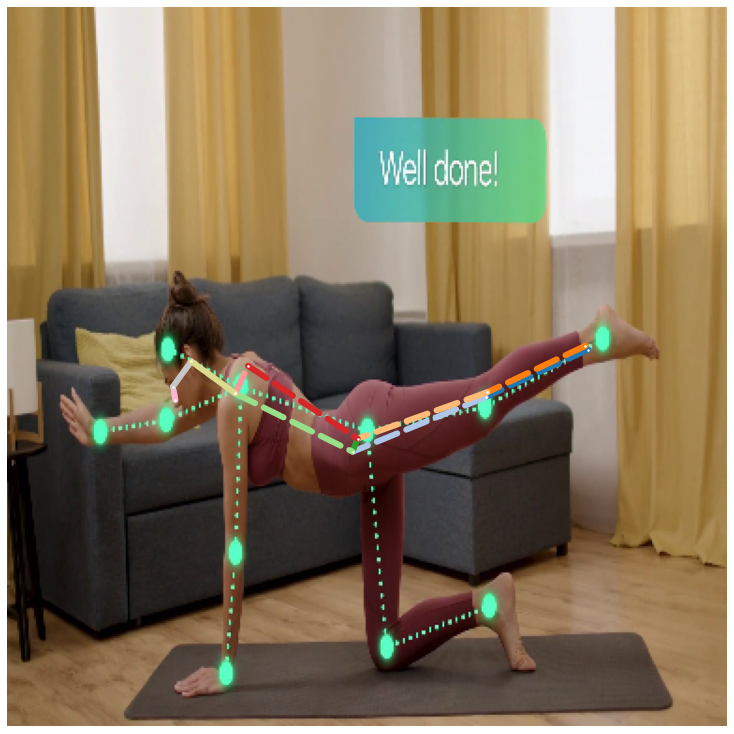

1212
PREDICTIONS NONE


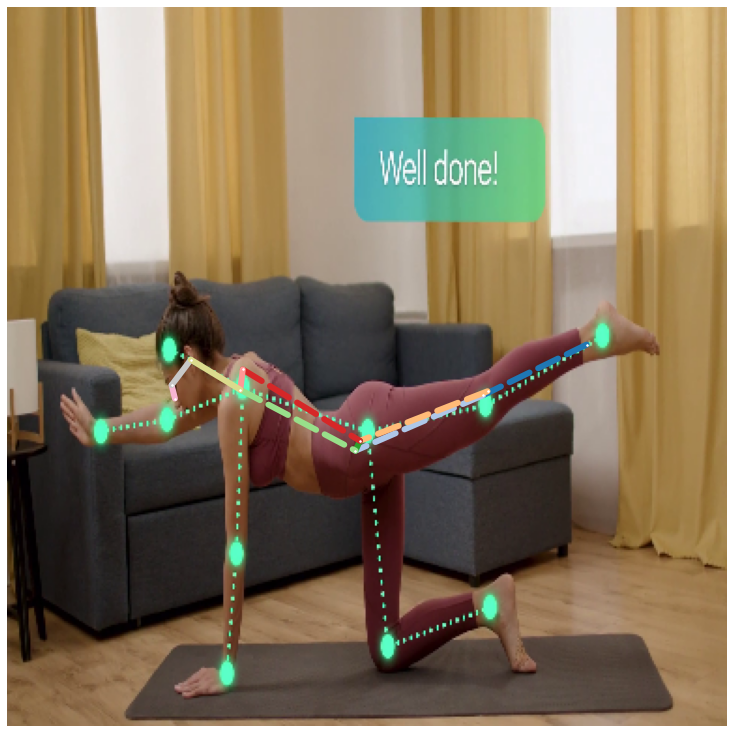

1215
PREDICTIONS NONE


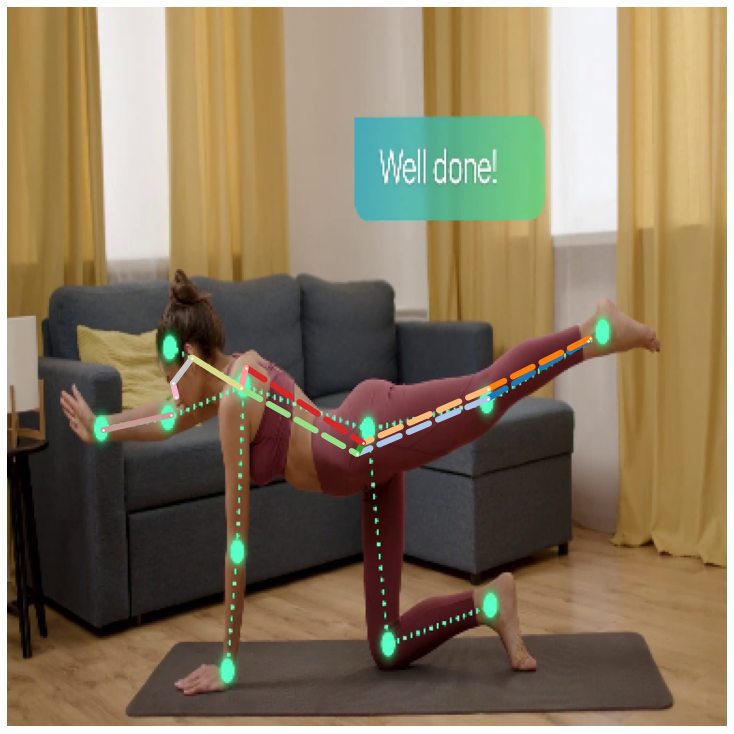

1218
PREDICTIONS NONE


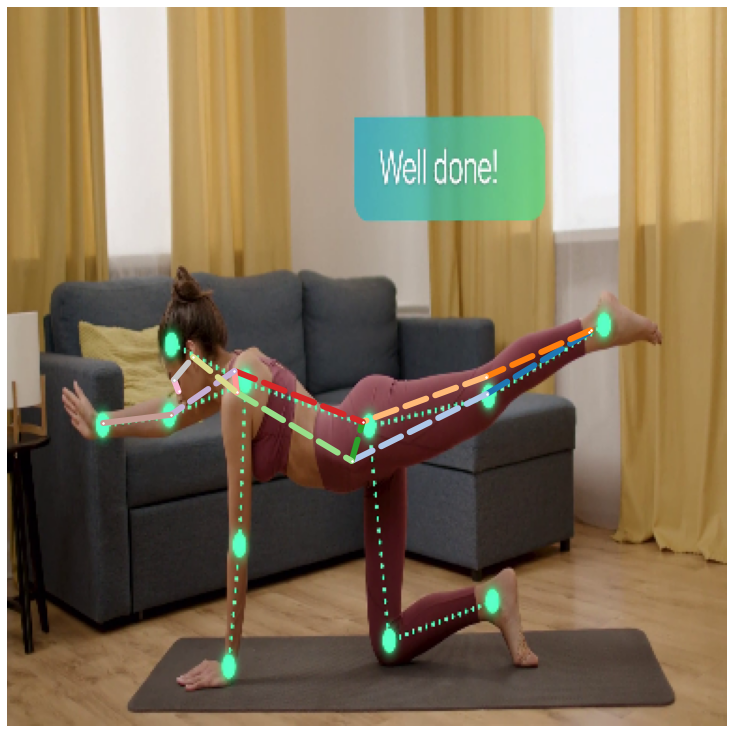

1221
PREDICTIONS NONE


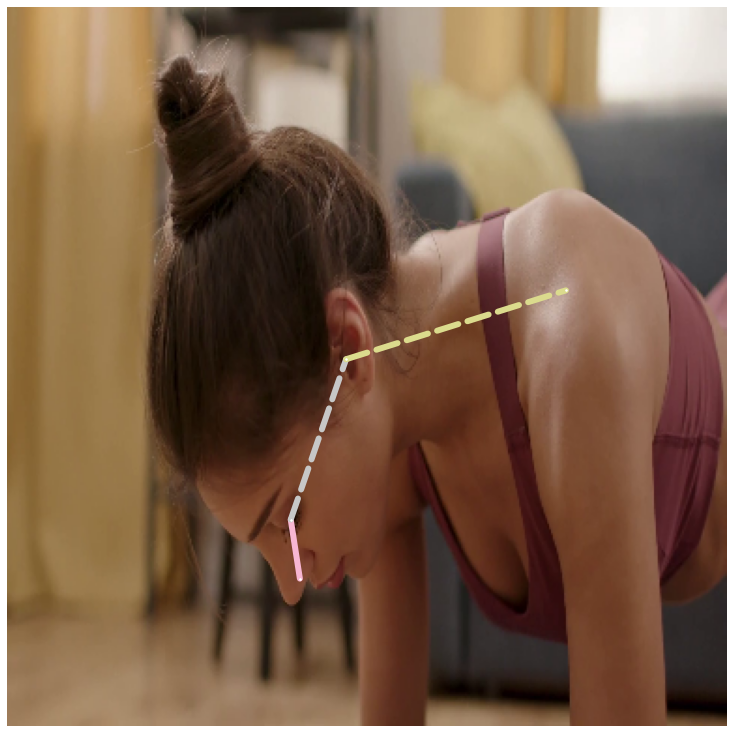

1224
PREDICTIONS NONE


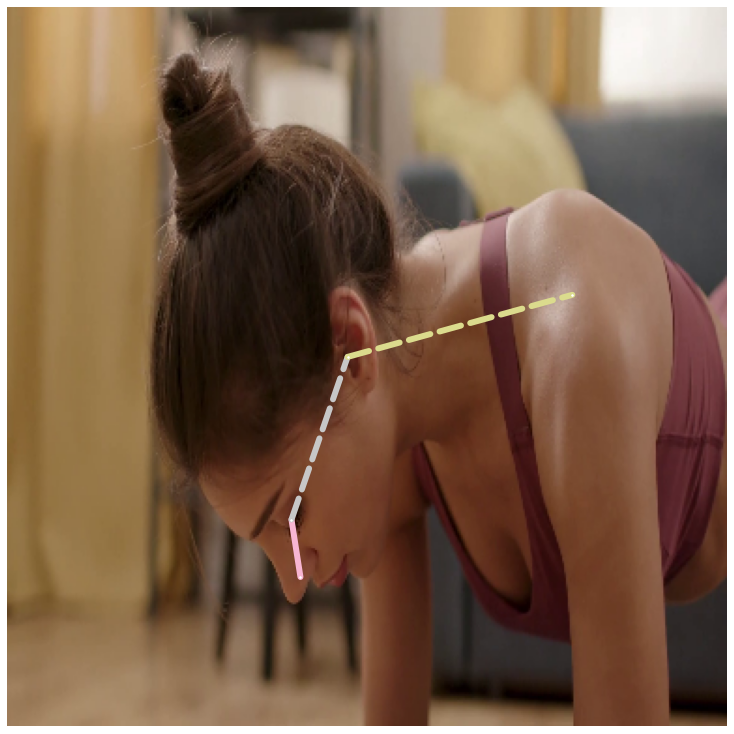

1227
PREDICTIONS NONE


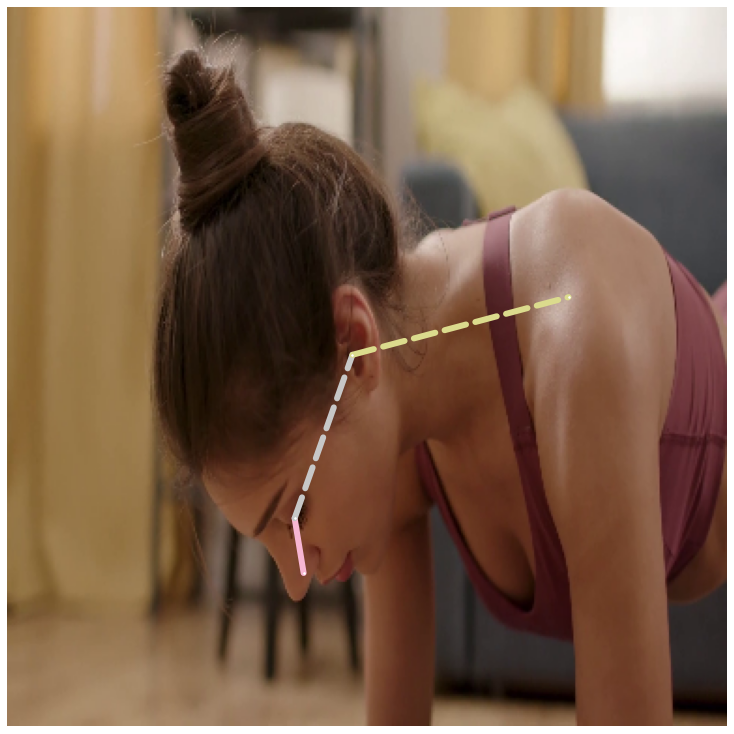

1230
PREDICTIONS NONE


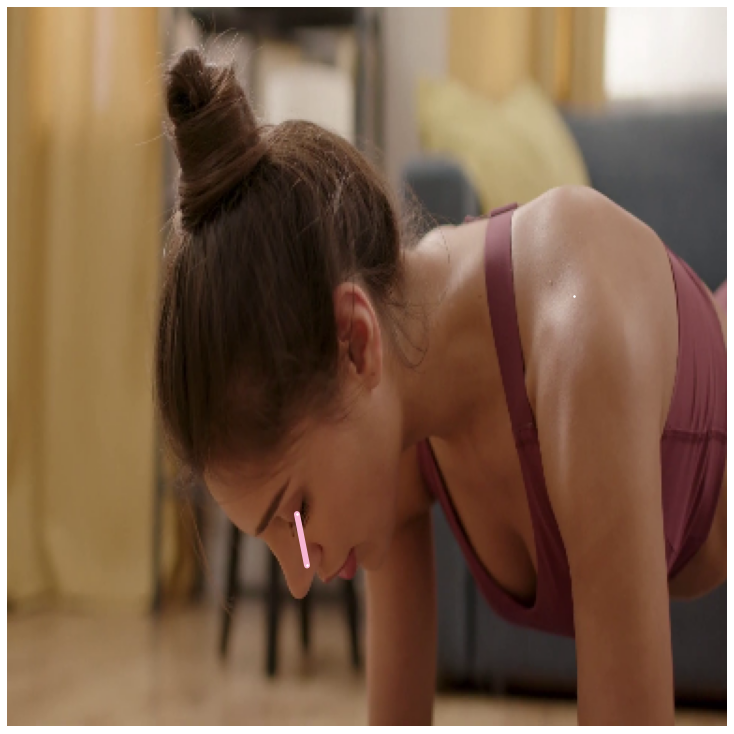

1233
PREDICTIONS NONE


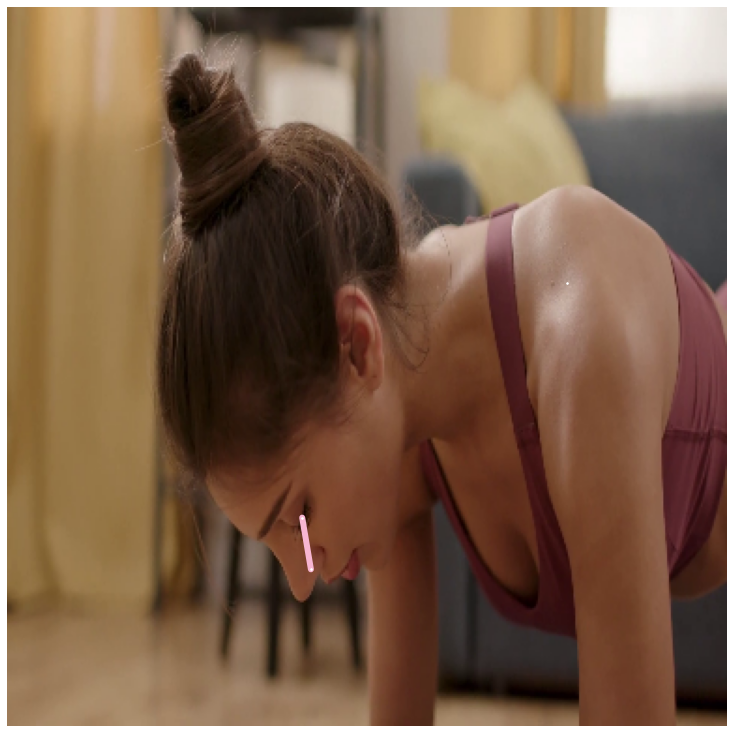

1236
PREDICTIONS NONE


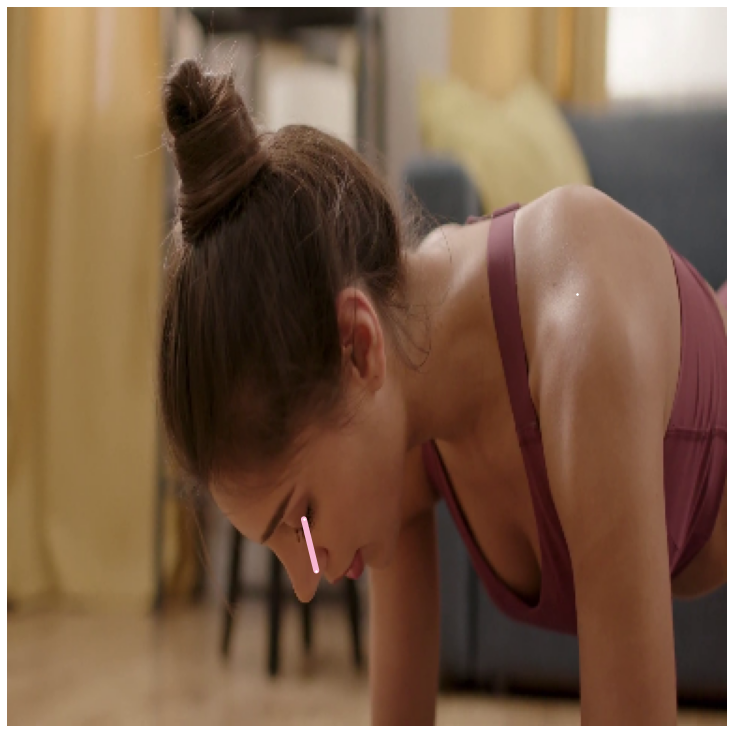

1239
PREDICTIONS NONE


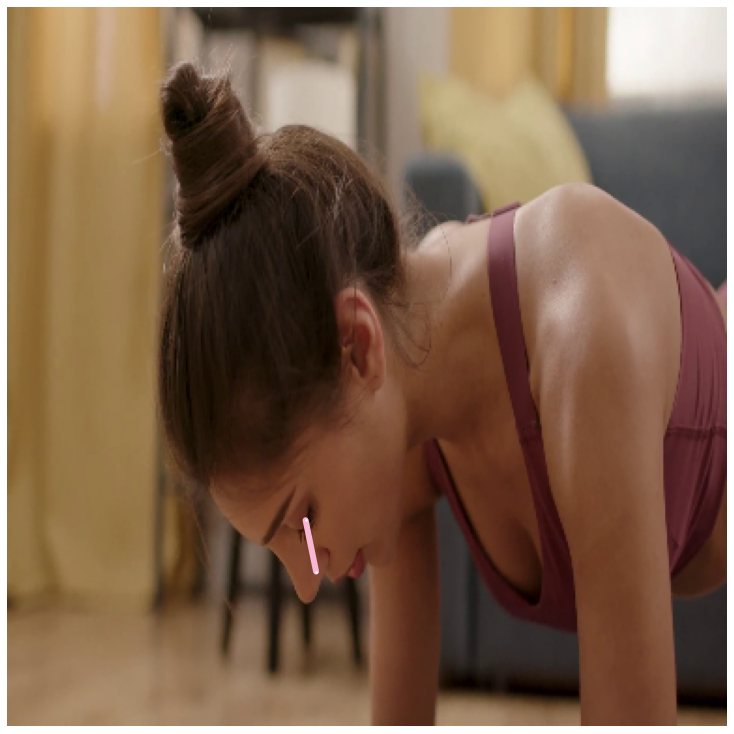

1242
PREDICTIONS NONE


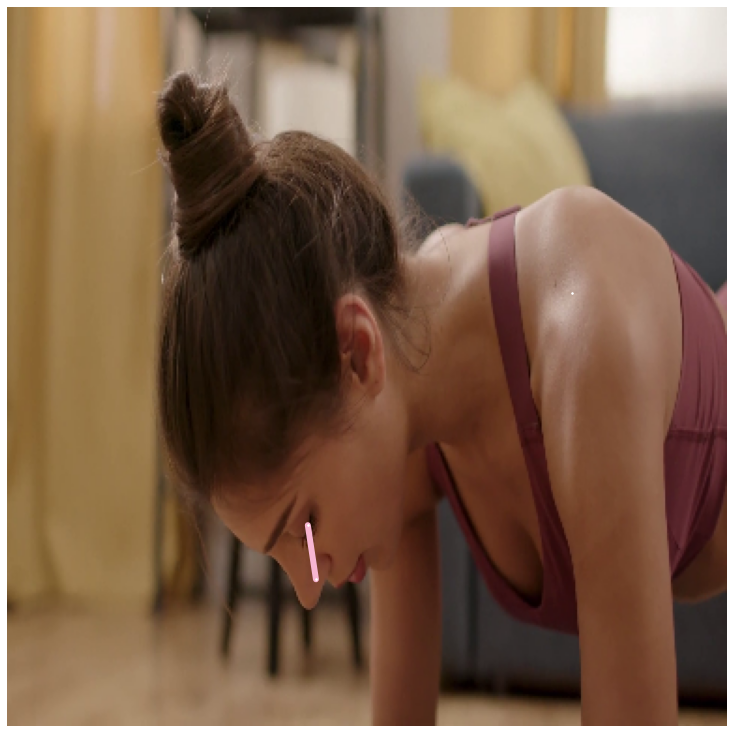

1245
PREDICTIONS NONE


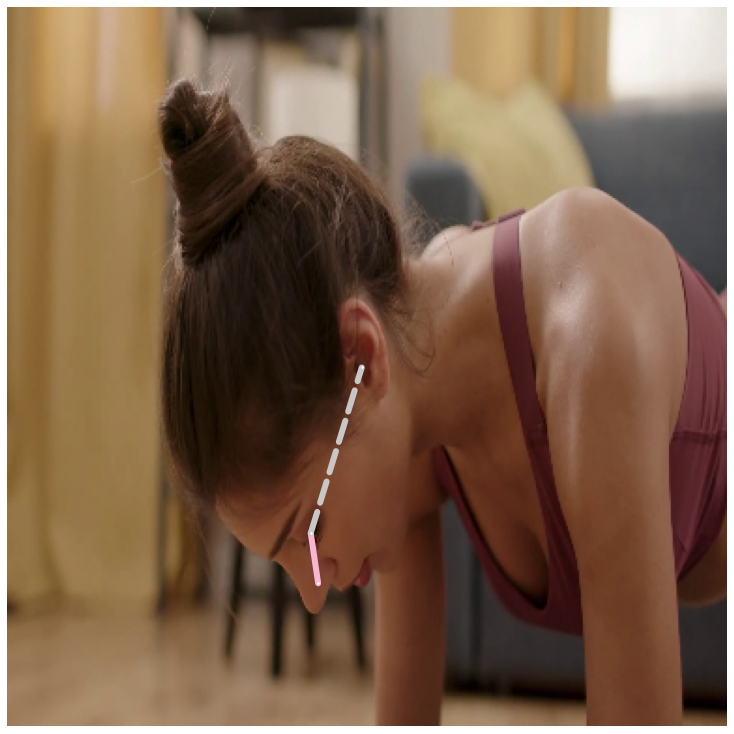

1248
PREDICTIONS NONE


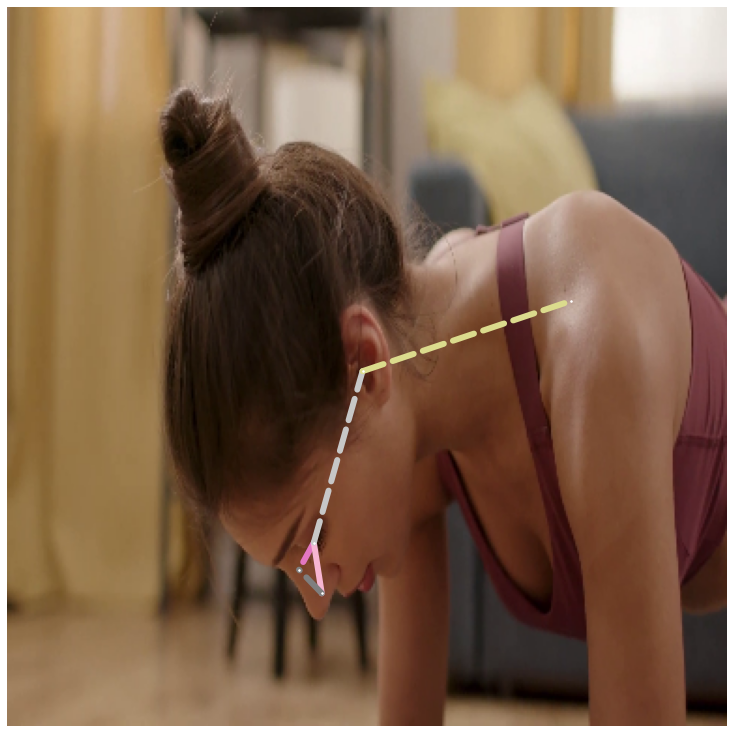

1251
PREDICTIONS NONE


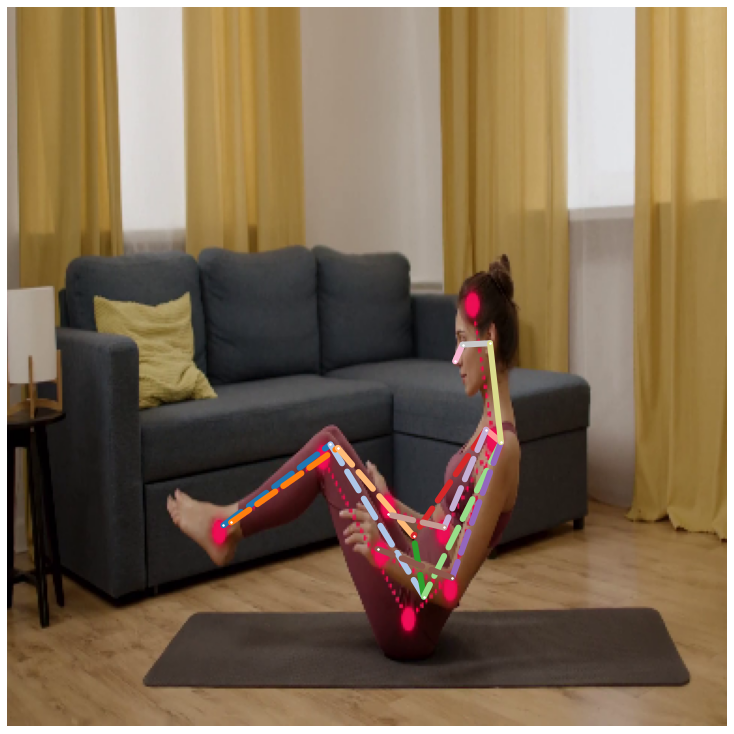

1254
PREDICTIONS NONE


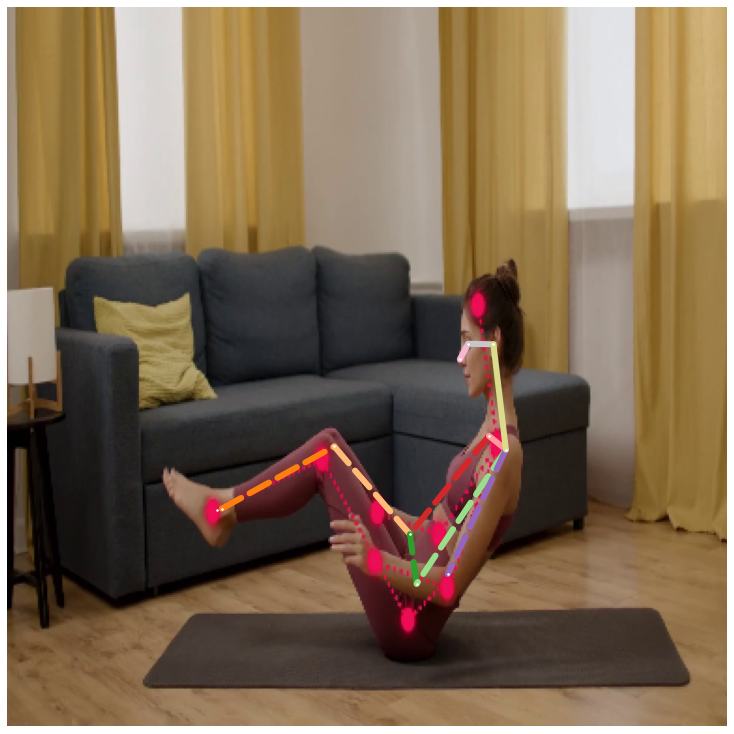

1257
PREDICTIONS NONE


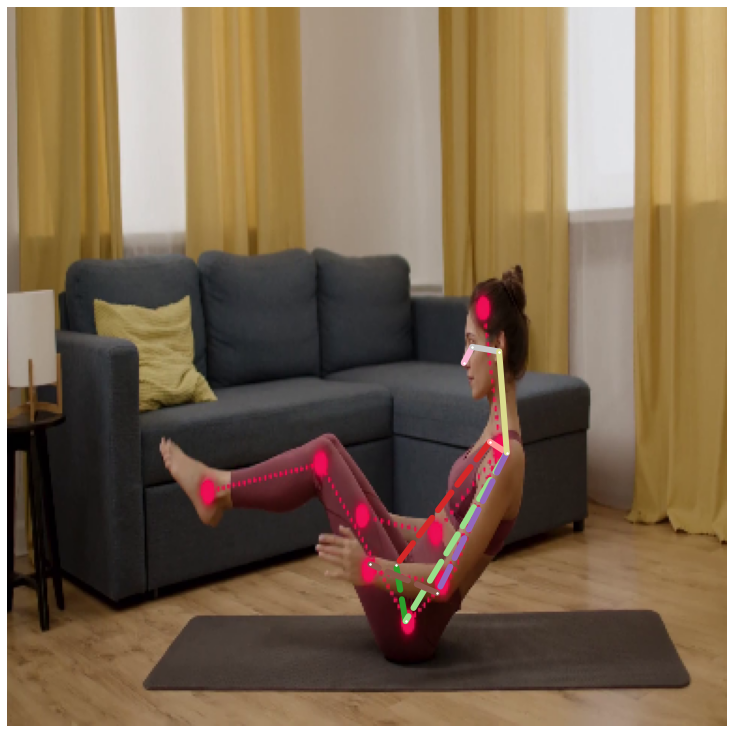

1260
PREDICTIONS NONE


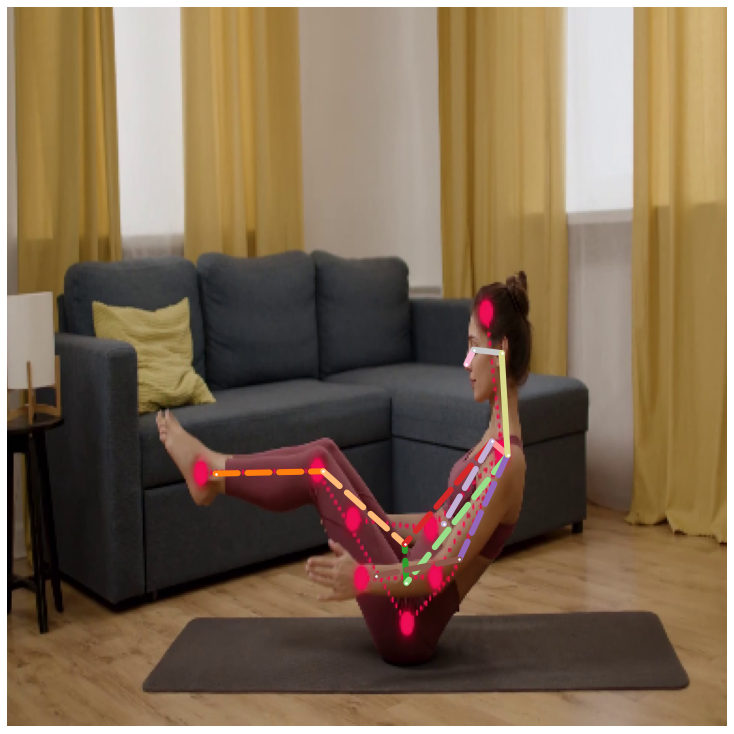

1263
PREDICTIONS NONE


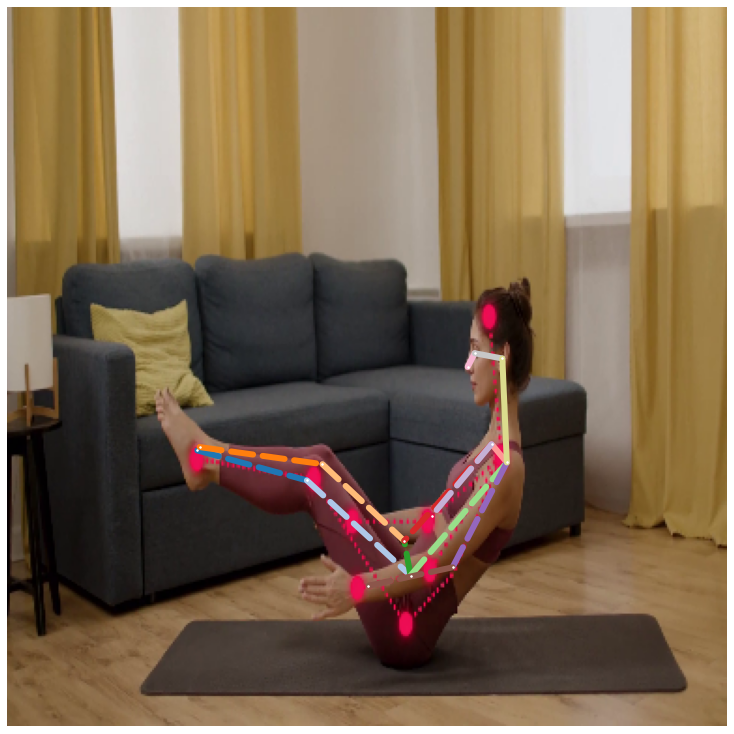

1266
PREDICTIONS NONE


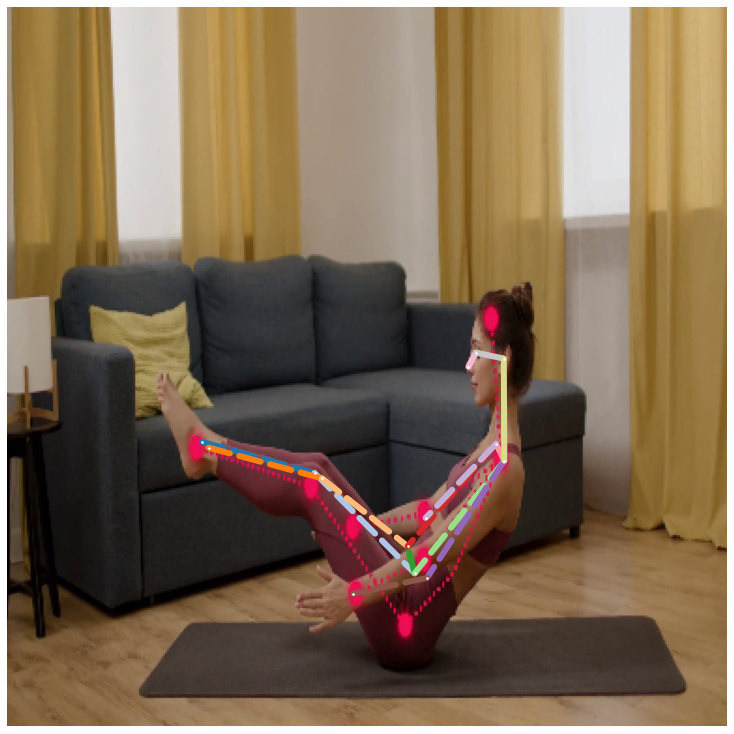

1269
PREDICTIONS NONE


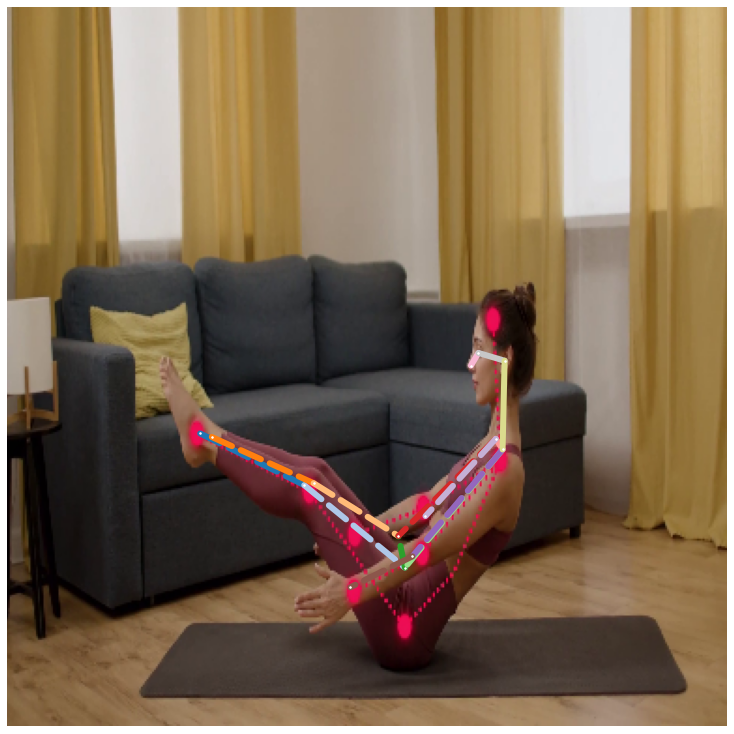

1272
PREDICTIONS NONE


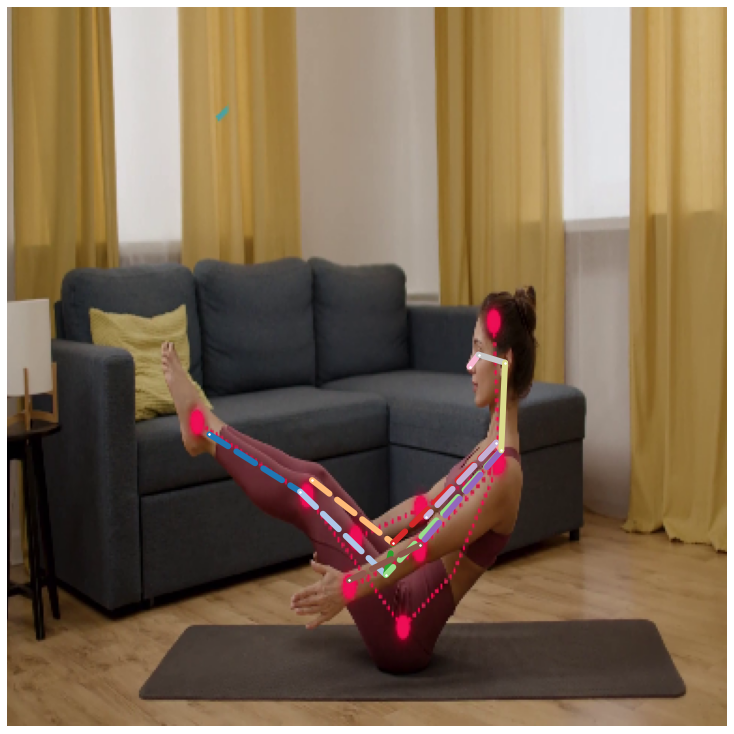

1275
PREDICTIONS NONE


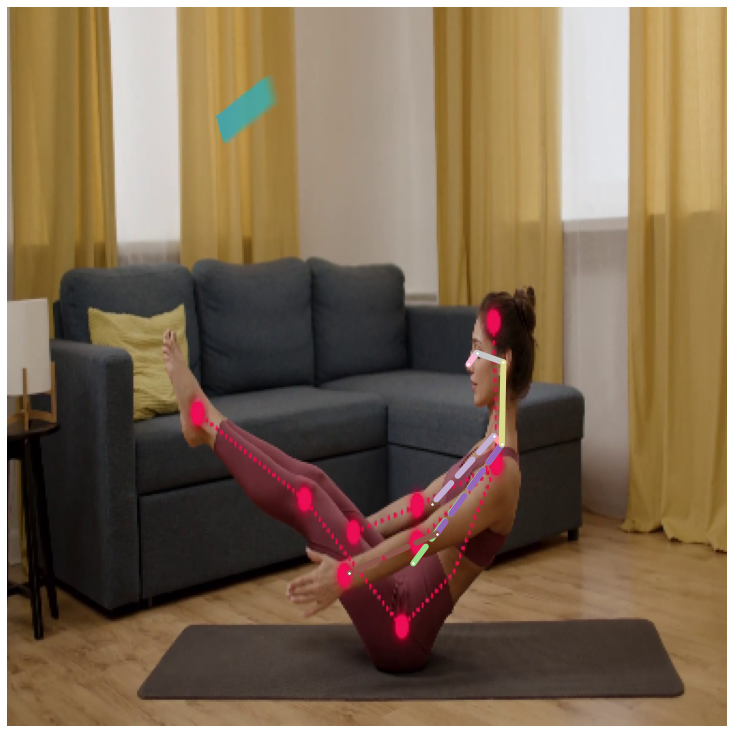

1278
PREDICTIONS NONE


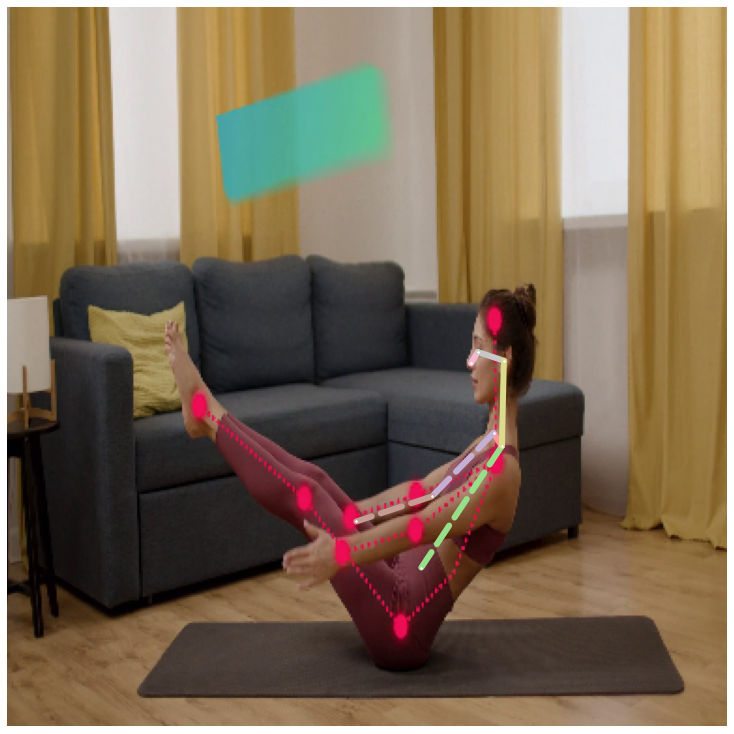

1281
PREDICTIONS NONE


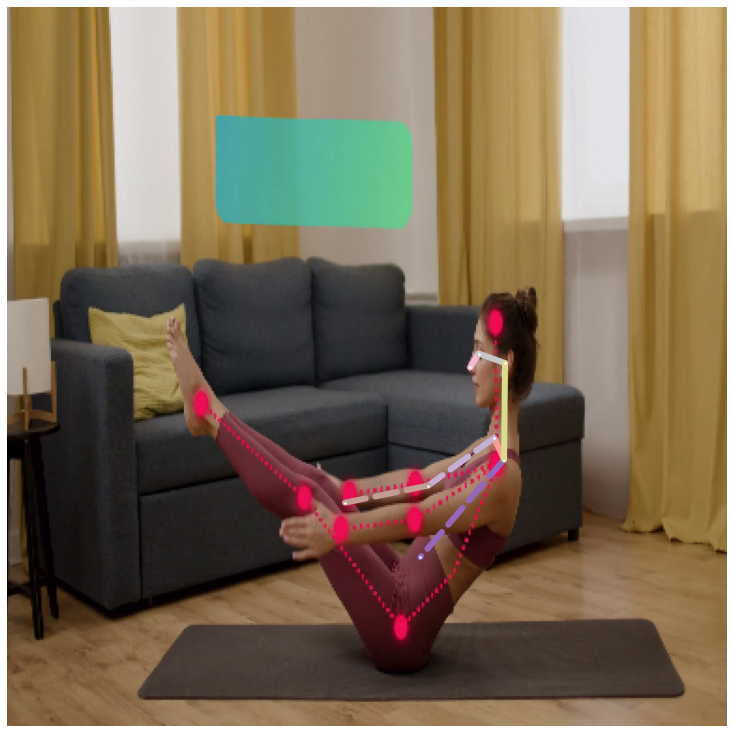

1284
PREDICTIONS NONE


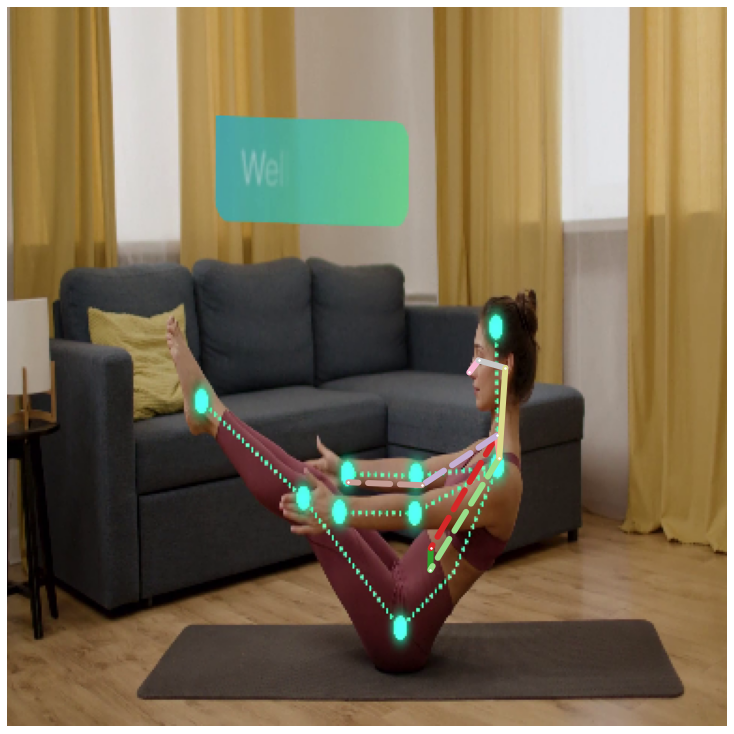

1287
PREDICTIONS NONE


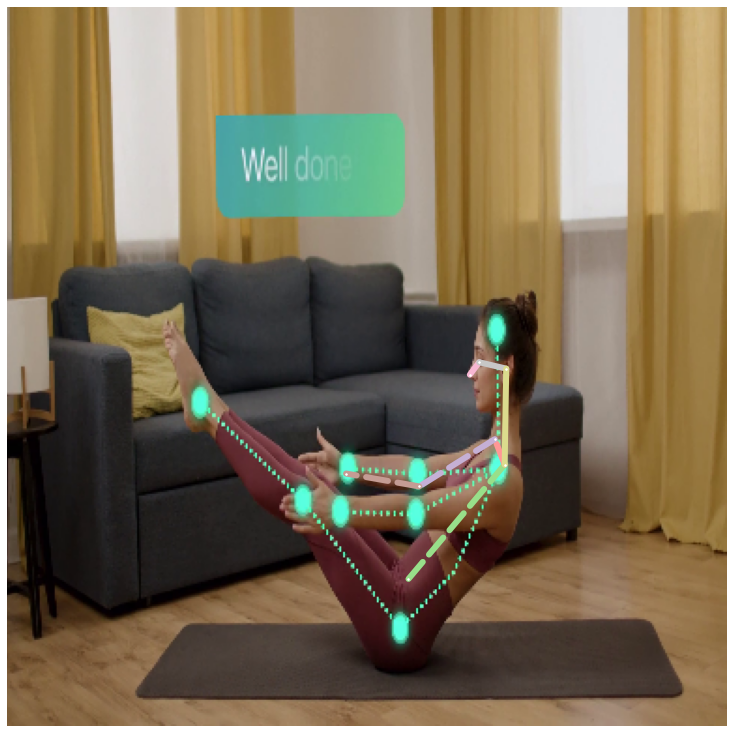

1290
PREDICTIONS NONE


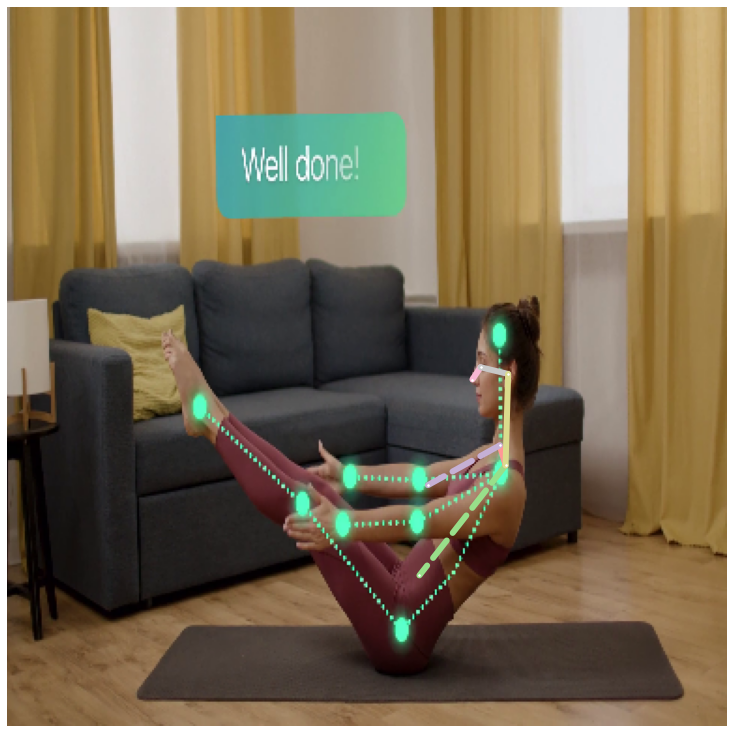

1293
PREDICTIONS NONE


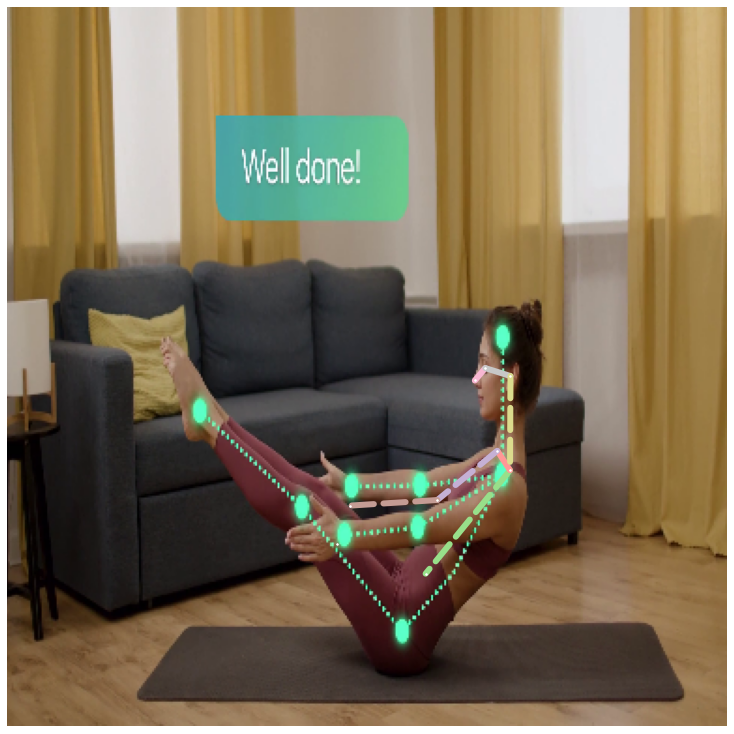

1296
PREDICTIONS NONE


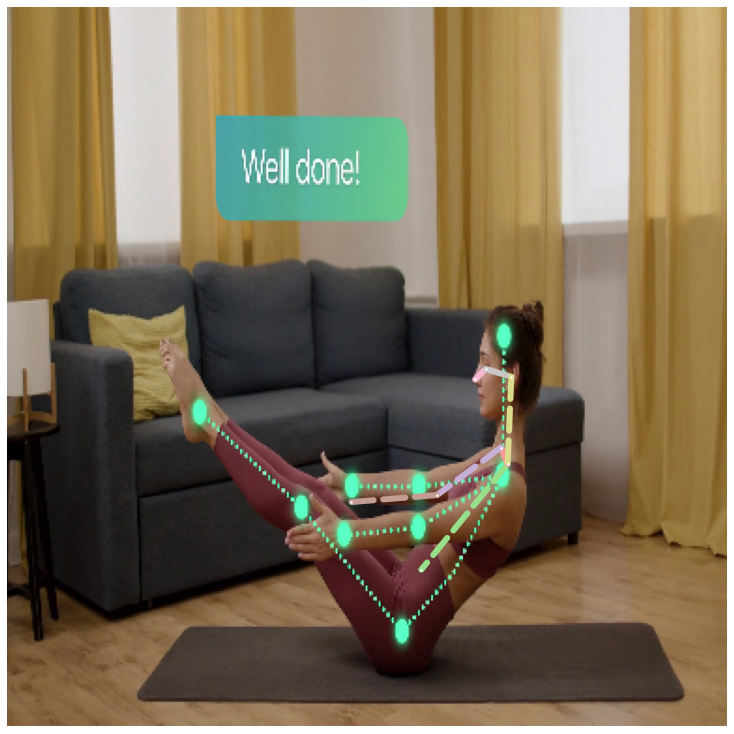

1299
PREDICTIONS NONE


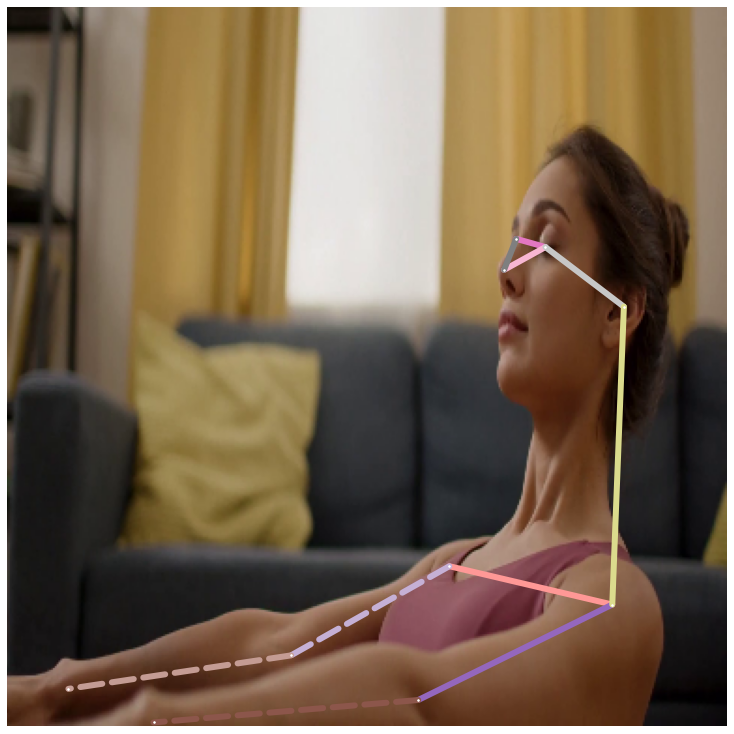

1302
PREDICTIONS NONE


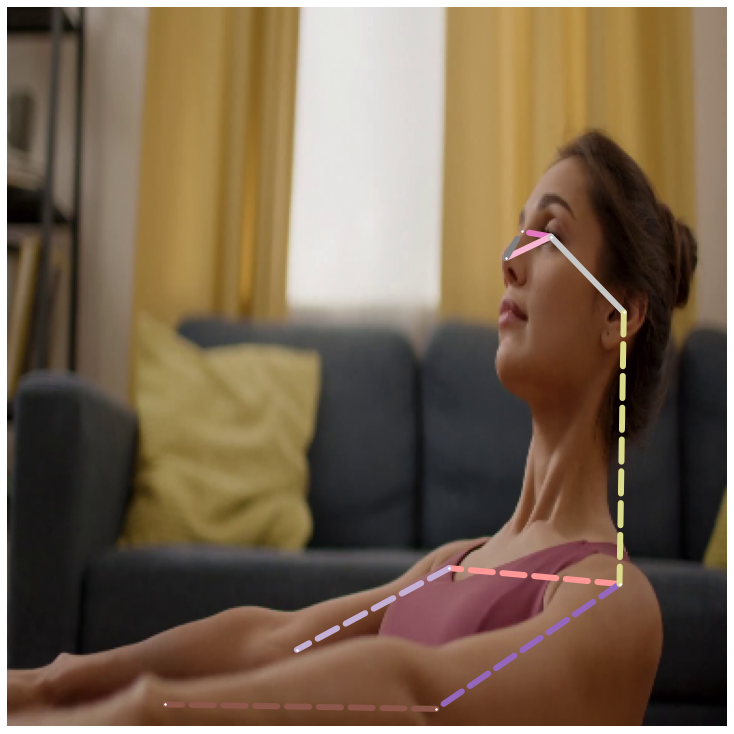

1305
PREDICTIONS NONE


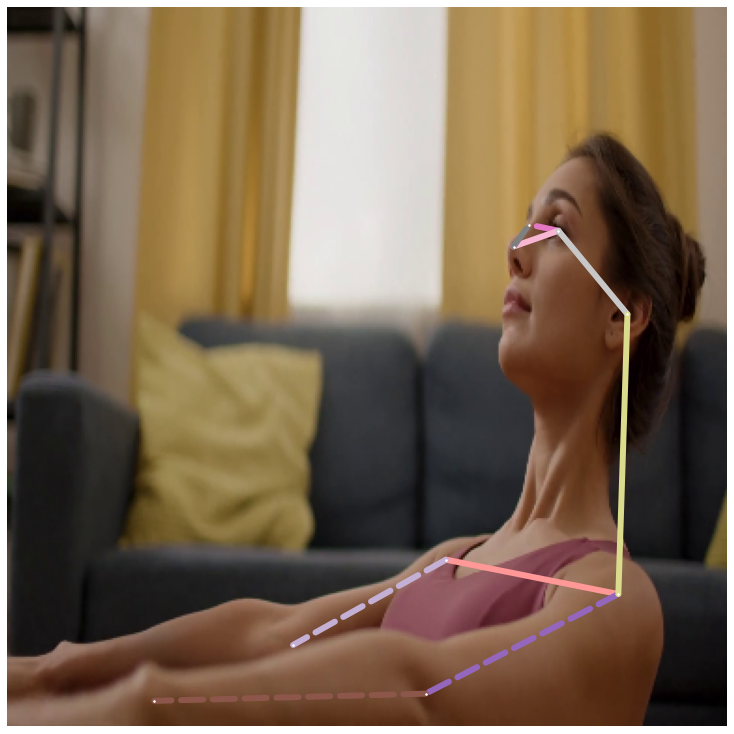

1308
PREDICTIONS NONE


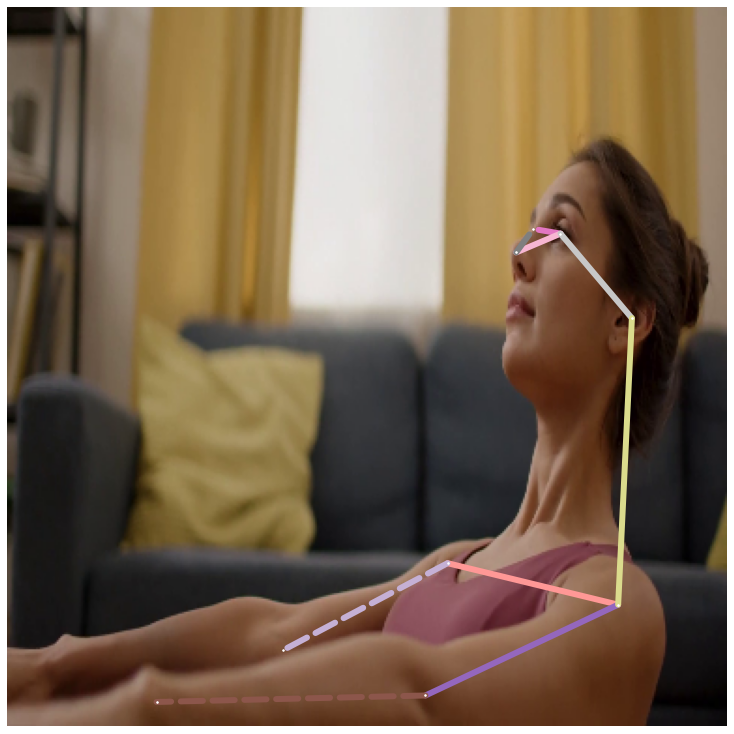

1311
PREDICTIONS NONE


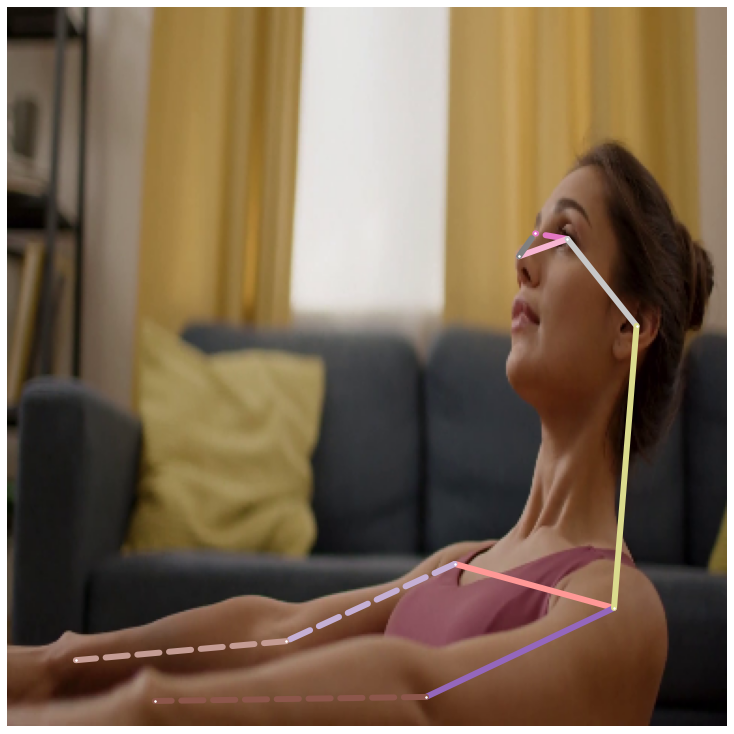

1314
PREDICTIONS NONE


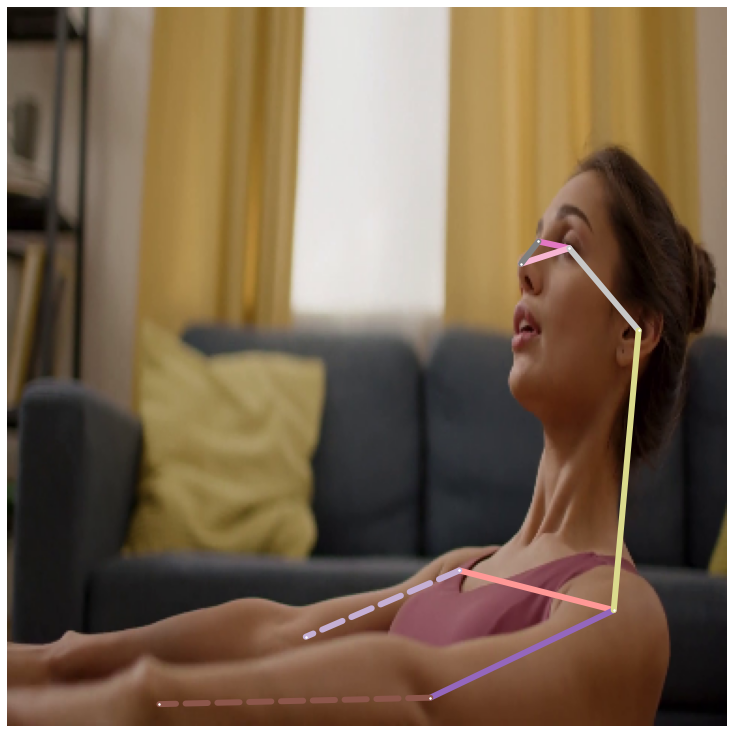

1317
PREDICTIONS NONE


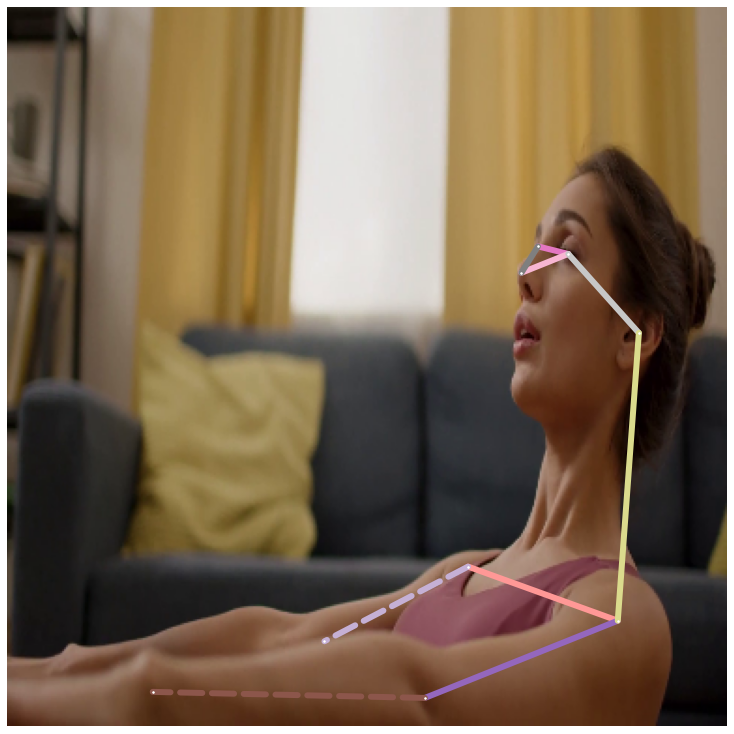

1320
PREDICTIONS NONE


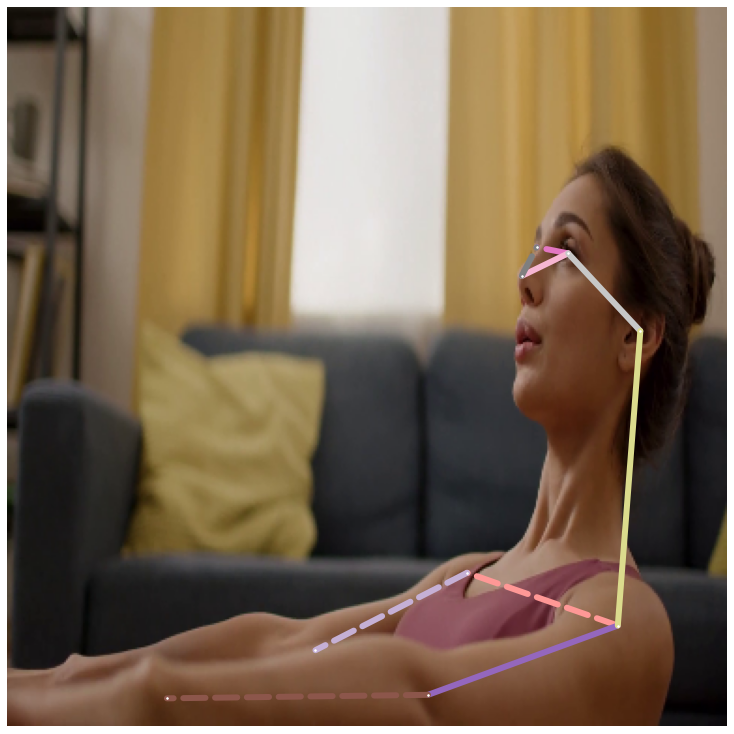

1323
PREDICTIONS NONE


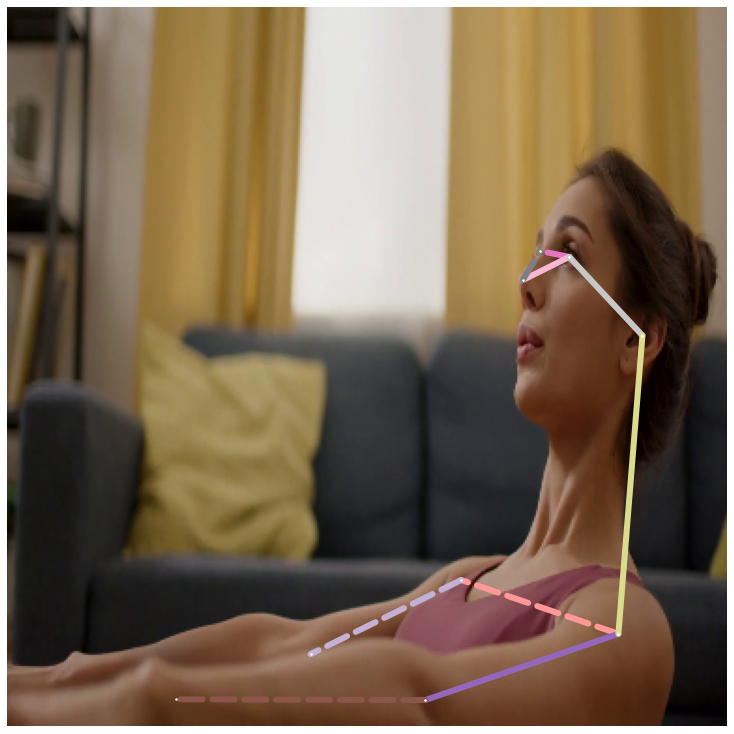

1326
PREDICTIONS NONE


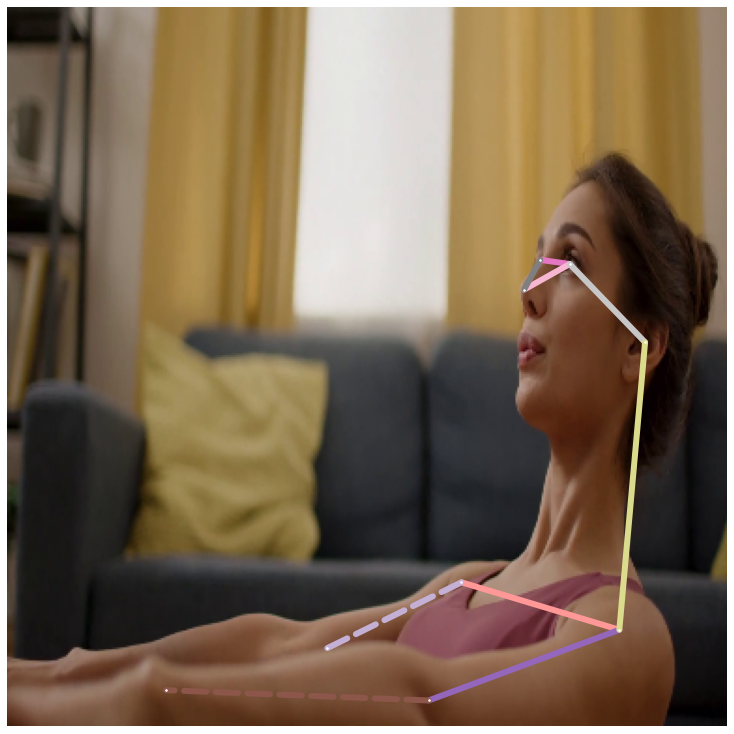

1329
PREDICTIONS NONE


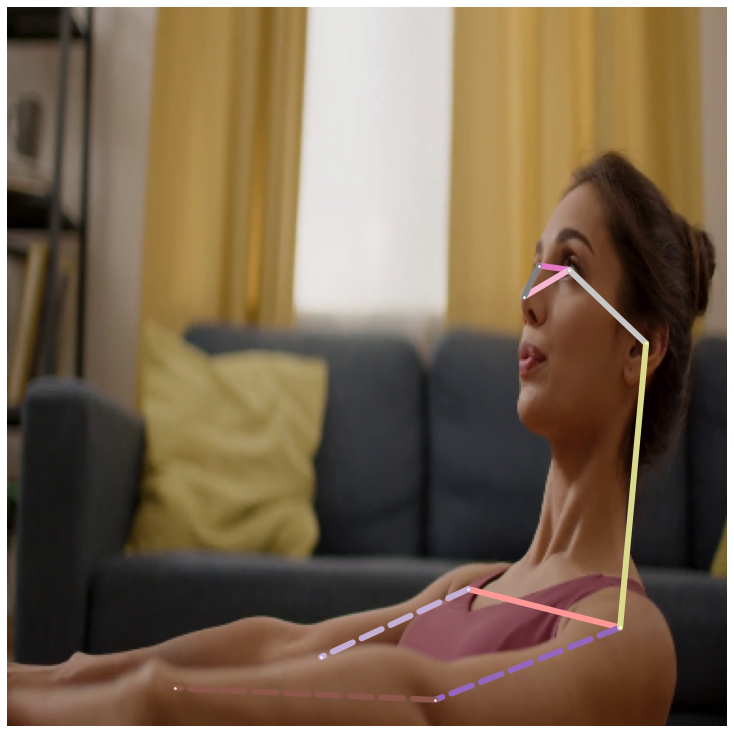

1332
PREDICTIONS NONE


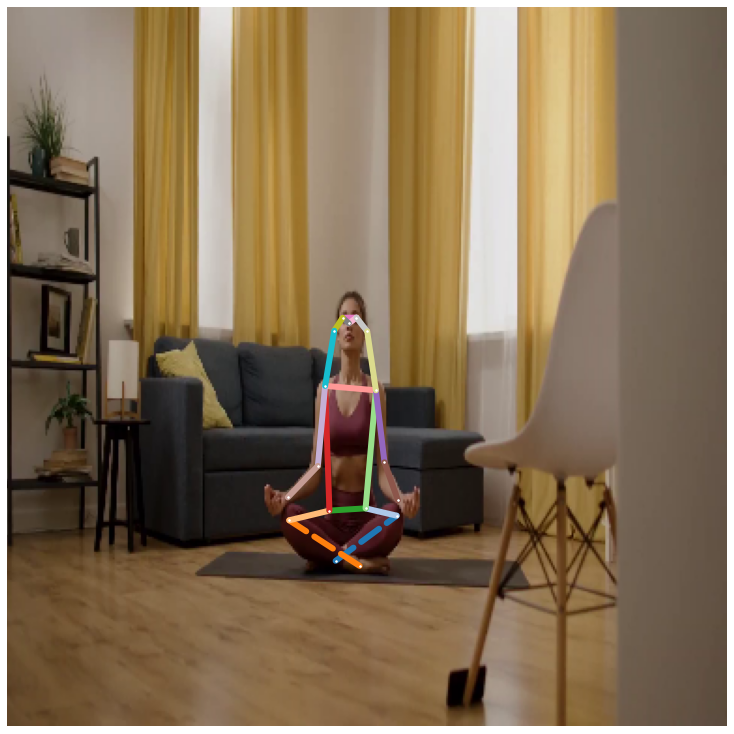

1335
PREDICTIONS NONE


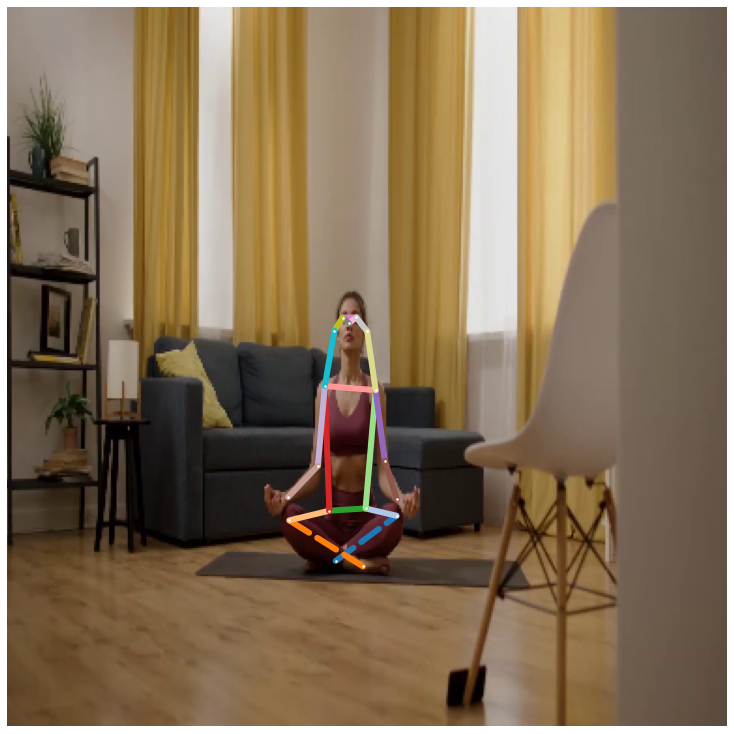

1338
PREDICTIONS NONE


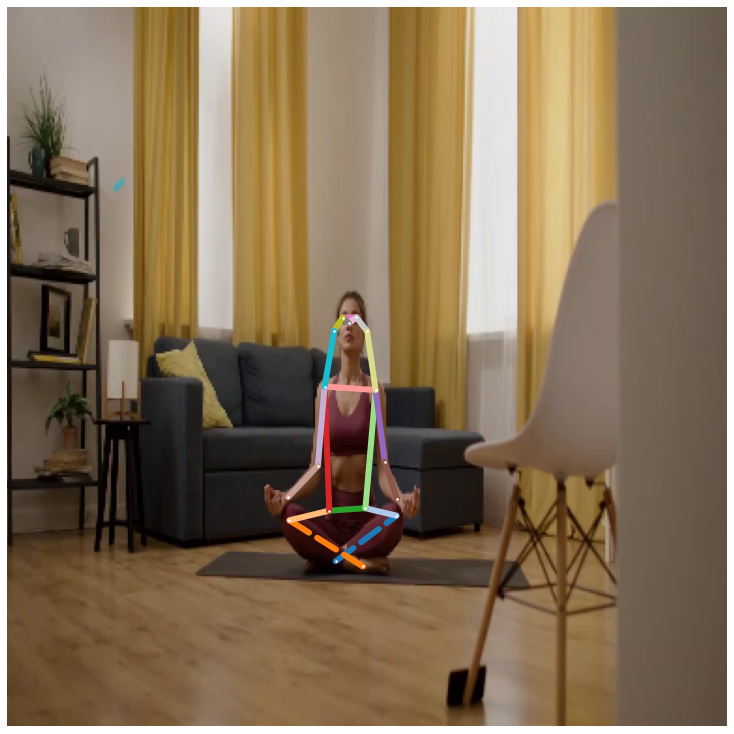

1341
PREDICTIONS NONE


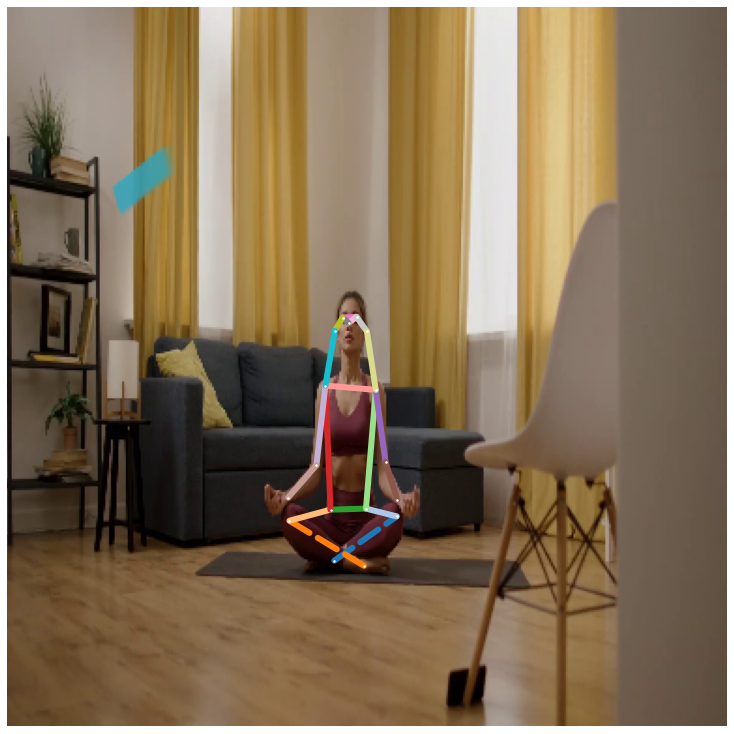

1344
PREDICTIONS NONE


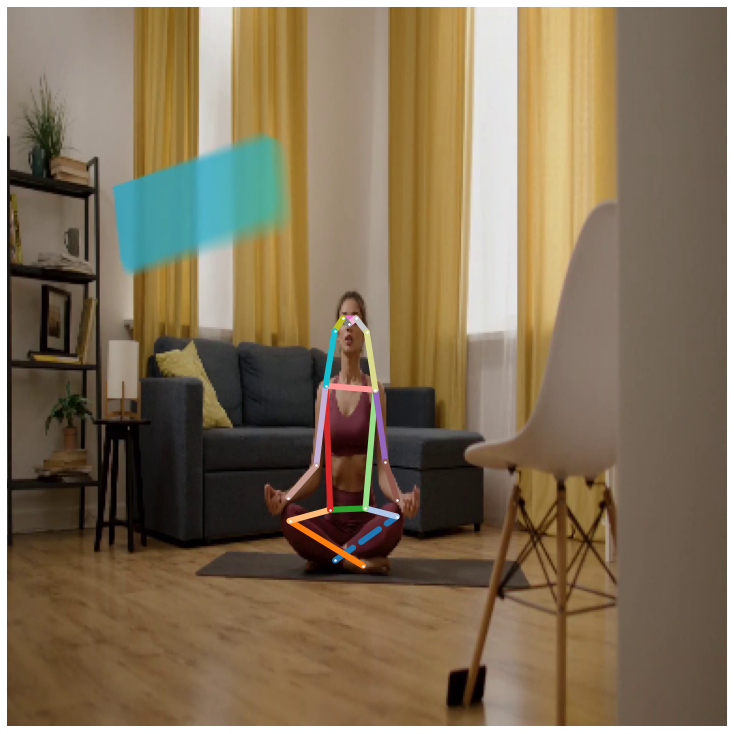

1347
PREDICTIONS NONE


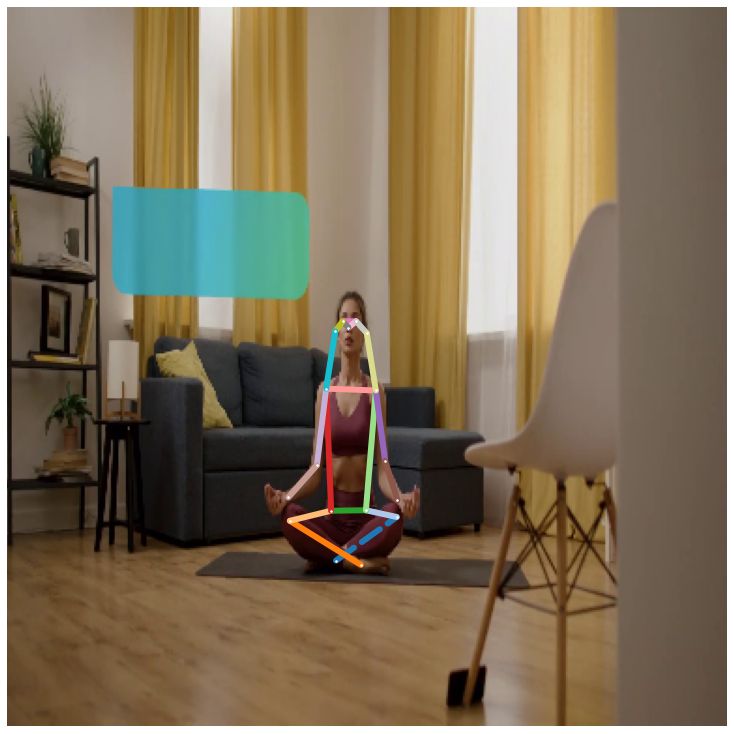

1350
PREDICTIONS NONE


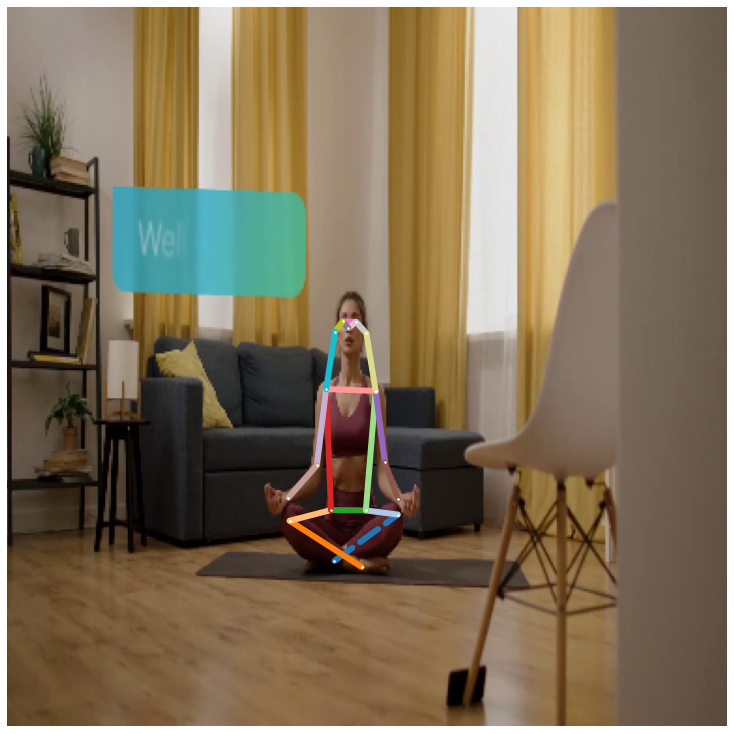

1353
PREDICTIONS NONE


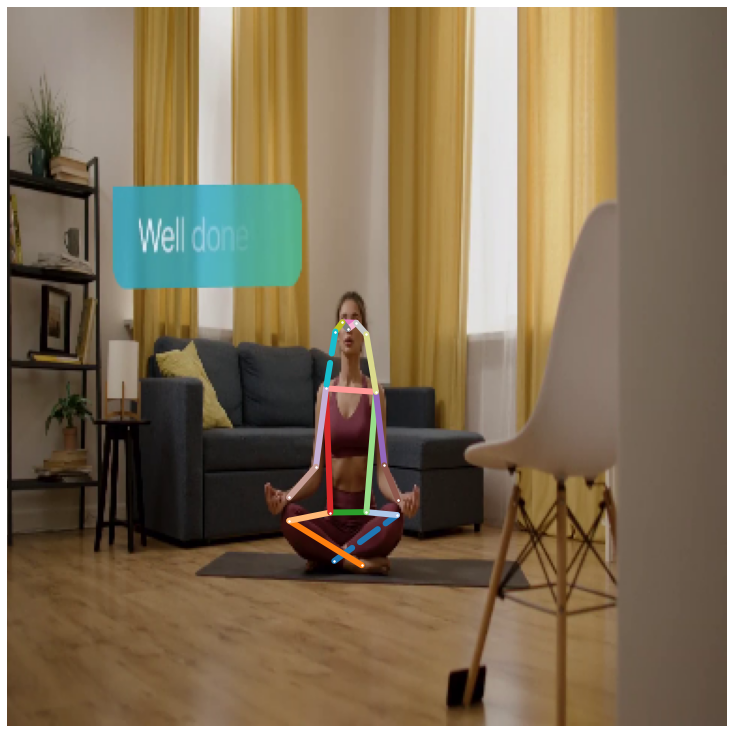

1356
PREDICTIONS NONE


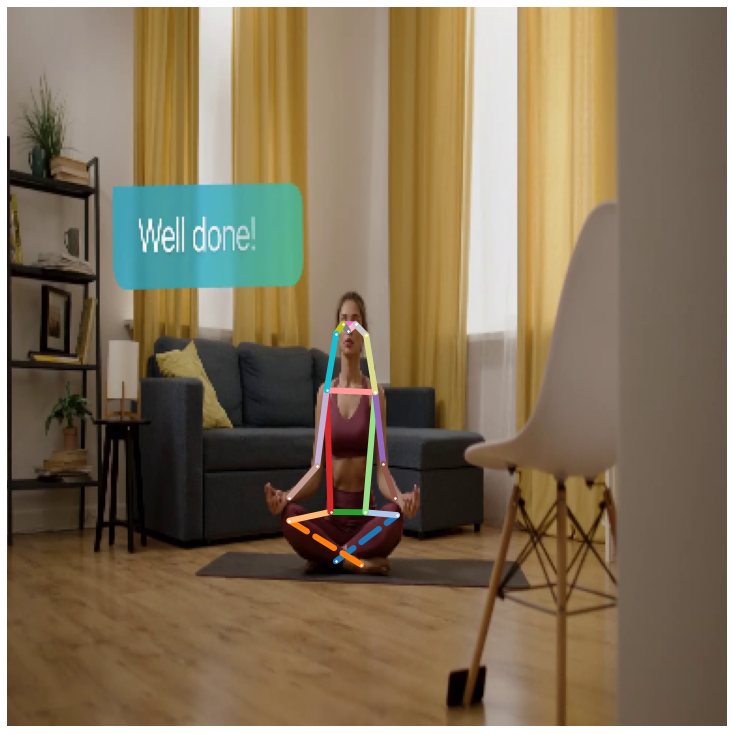

1359
PREDICTIONS NONE


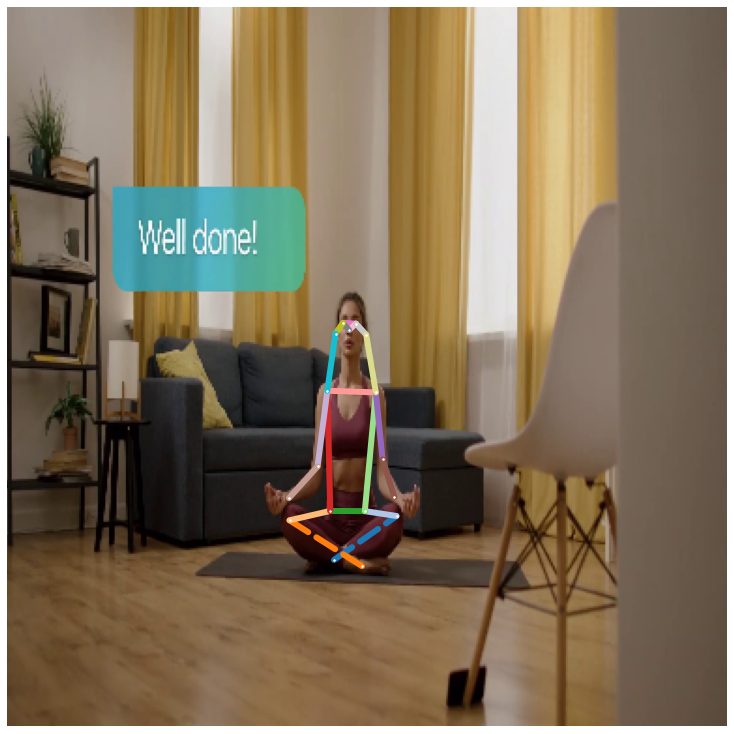

1362
PREDICTIONS NONE


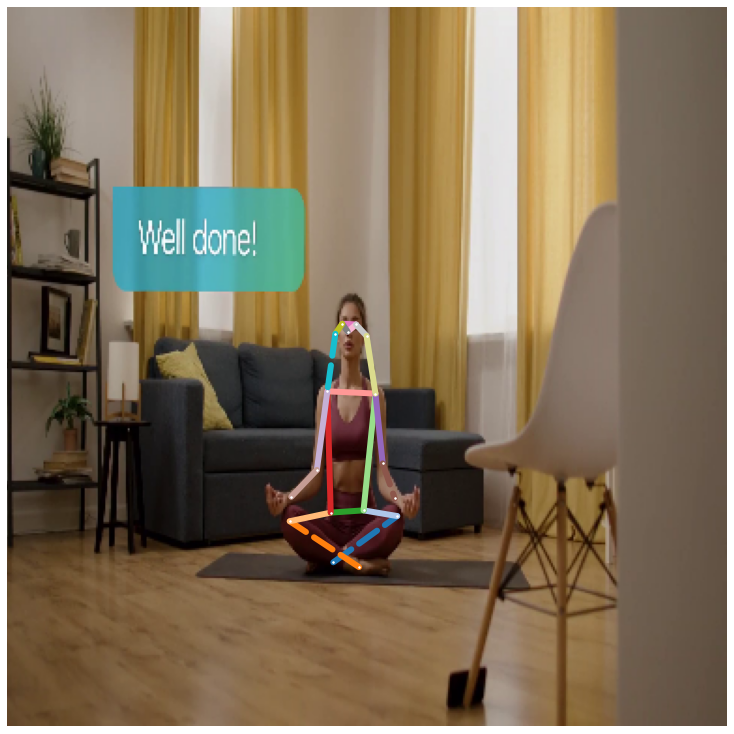

1365
PREDICTIONS NONE


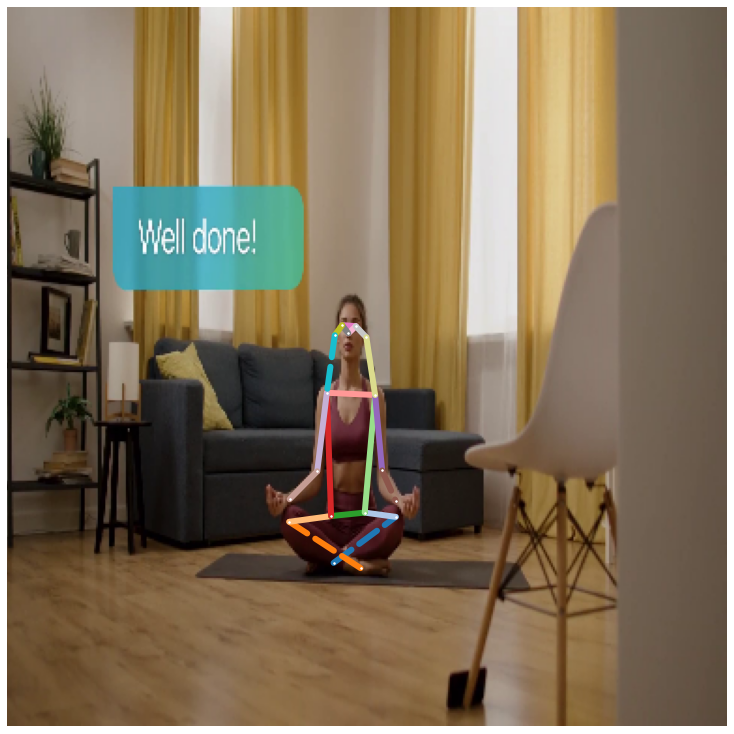

1368
PREDICTIONS NONE


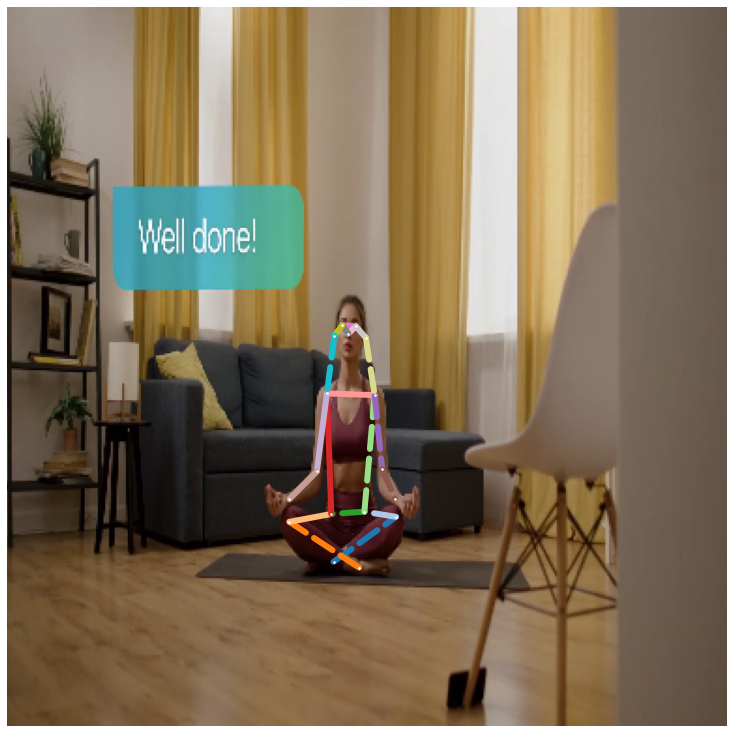

1371
PREDICTIONS NONE


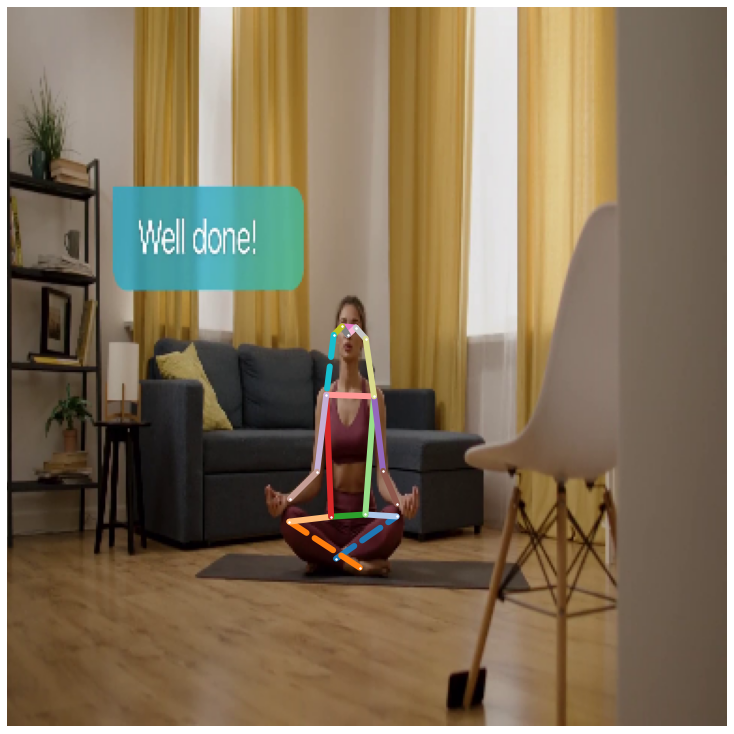

1374
PREDICTIONS NONE


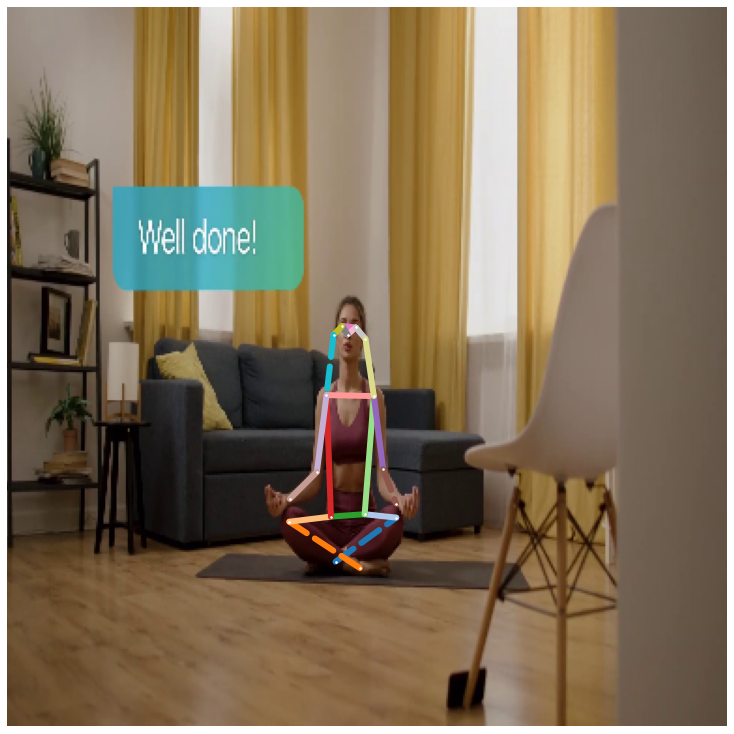

1377
PREDICTIONS NONE


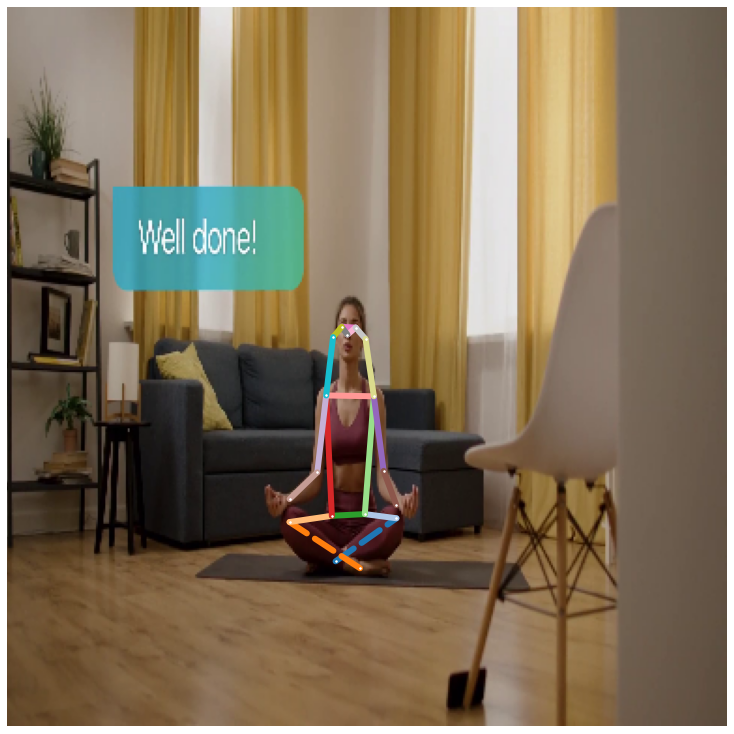

1380
PREDICTIONS NONE


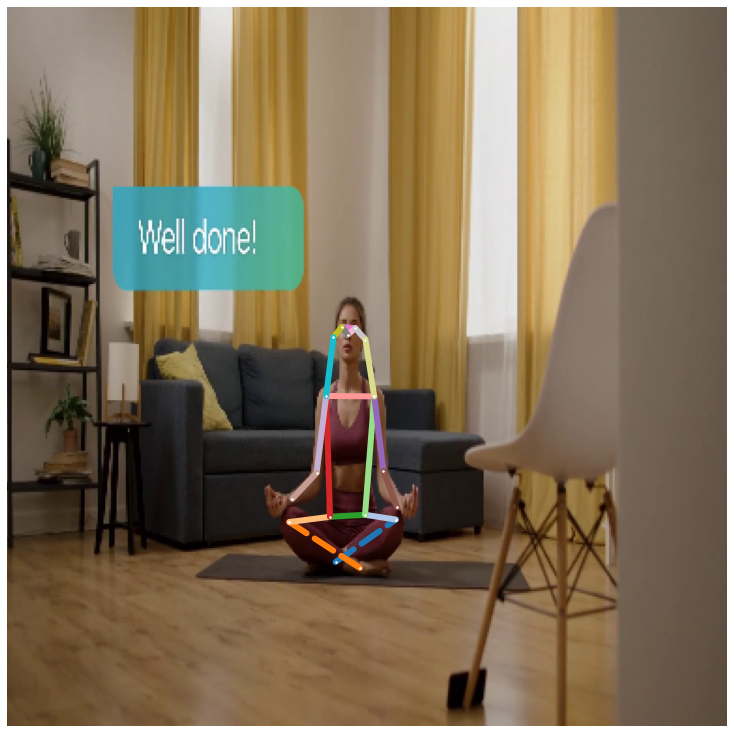

1383
PREDICTIONS NONE


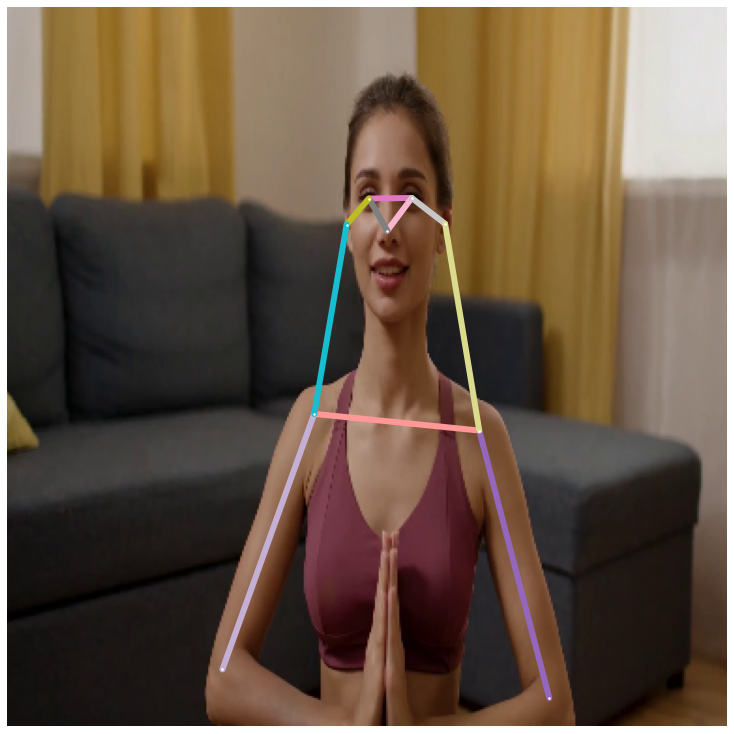

1386
PREDICTIONS NONE


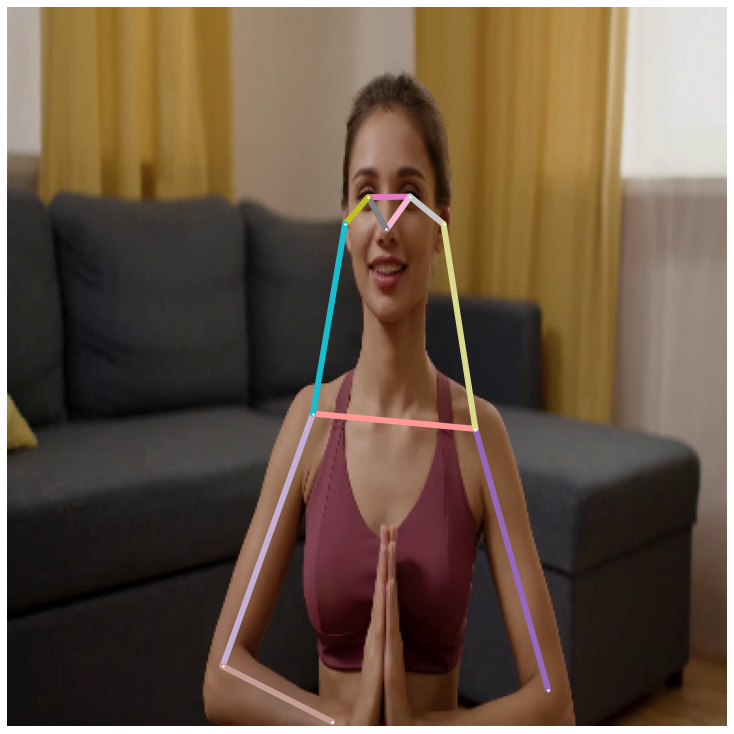

1389
PREDICTIONS NONE


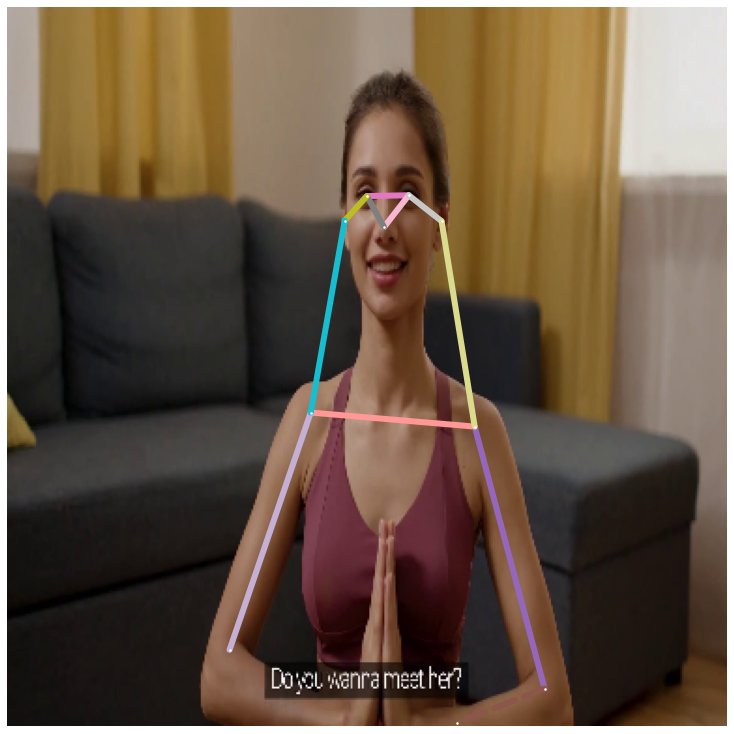

1392
PREDICTIONS NONE


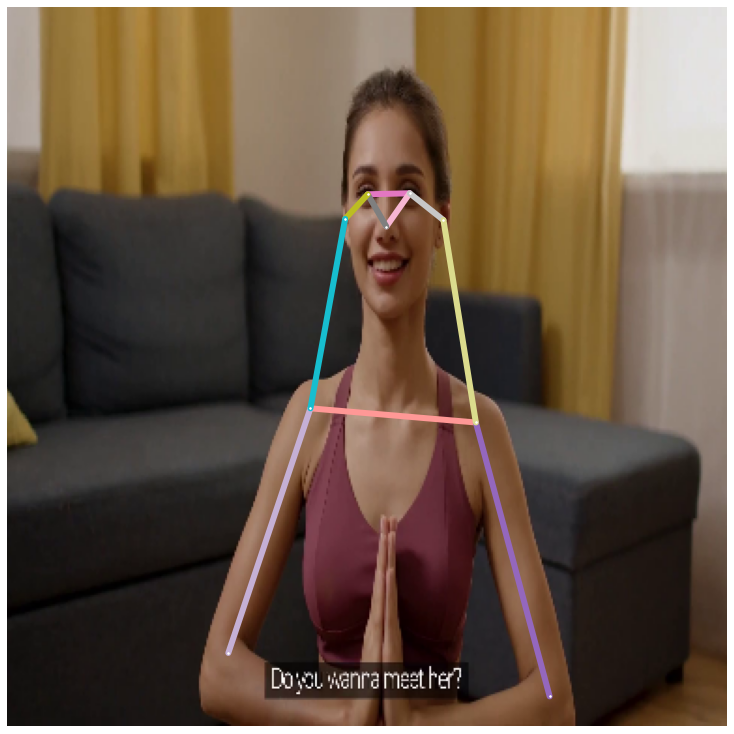

1395
PREDICTIONS NONE


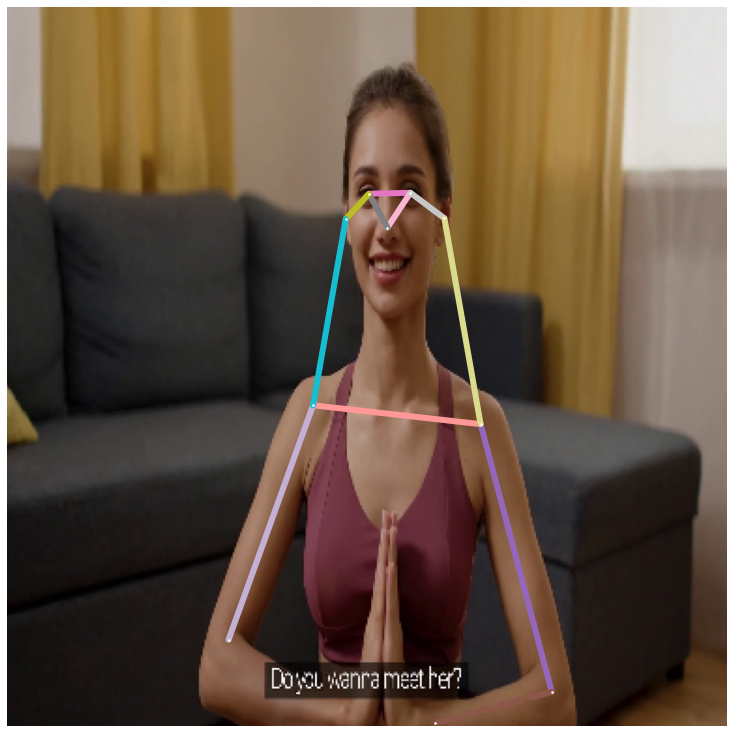

1398
PREDICTIONS NONE


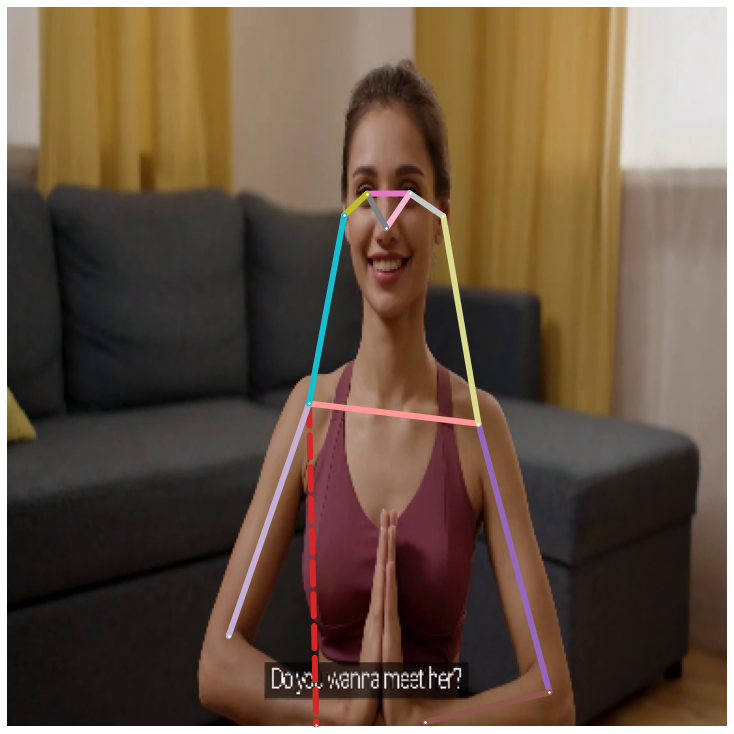

1401
PREDICTIONS NONE


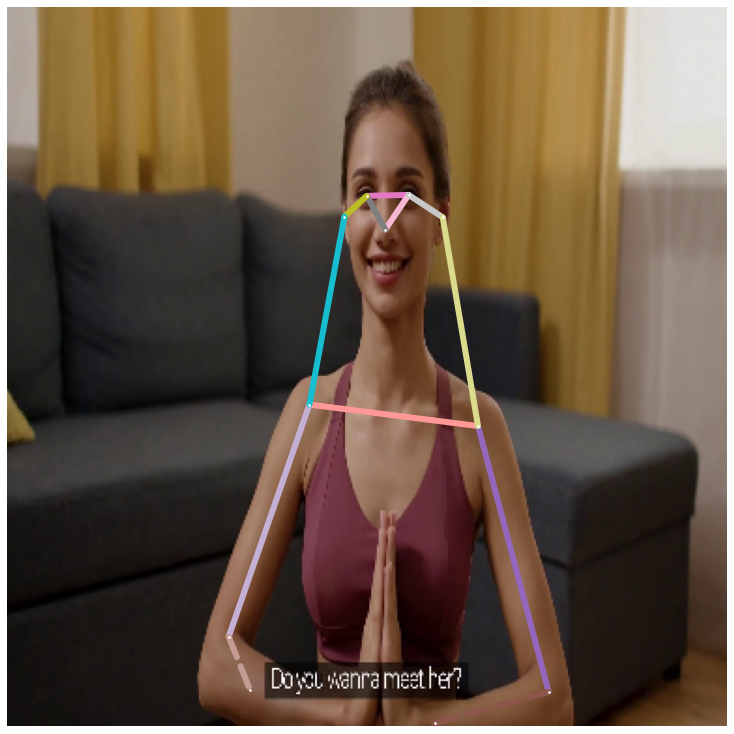

1404
PREDICTIONS NONE


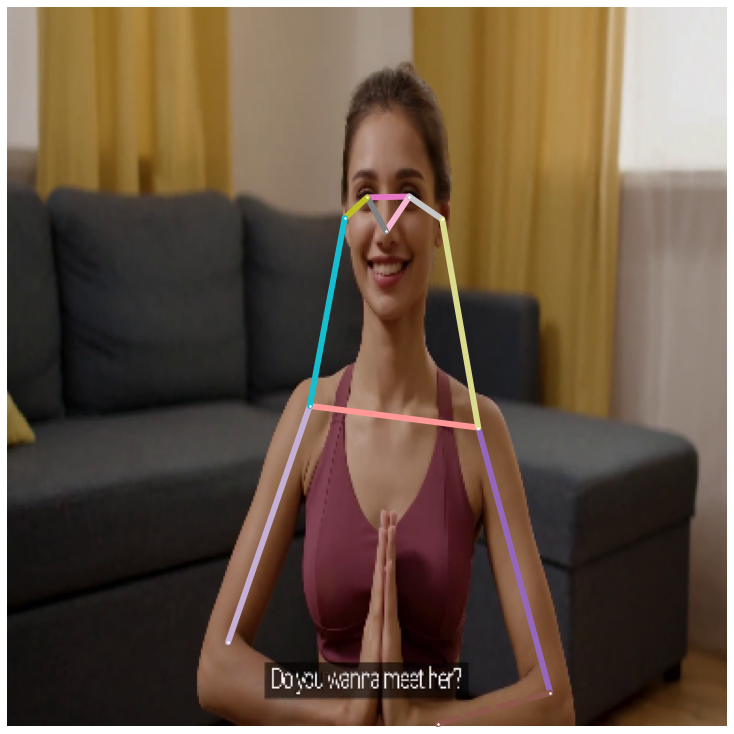

1407
PREDICTIONS NONE


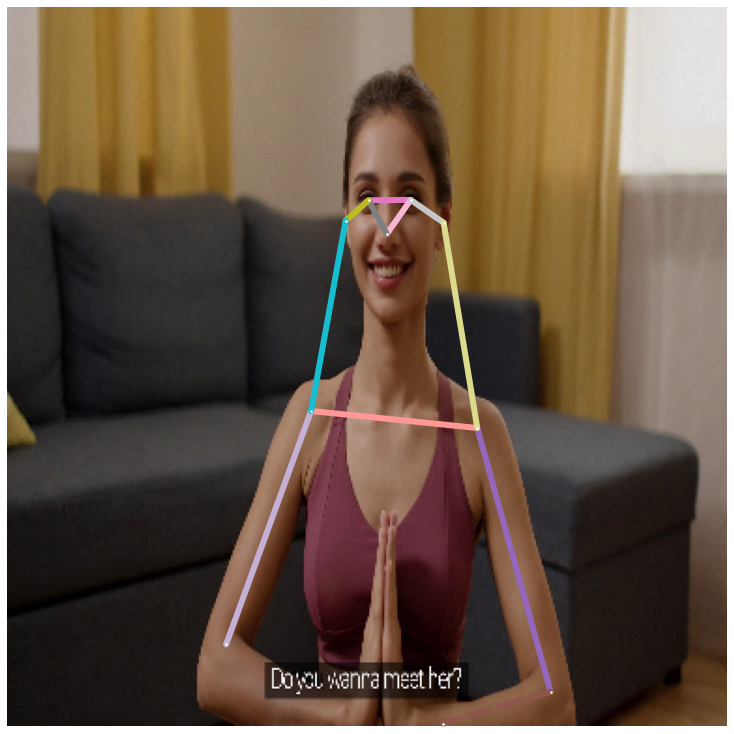

1410
PREDICTIONS NONE


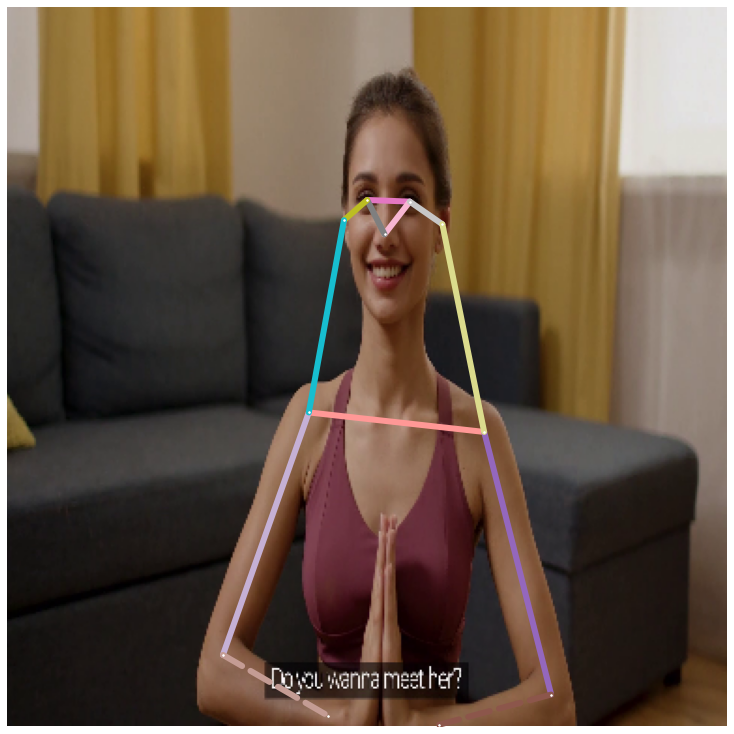

1413
PREDICTIONS NONE


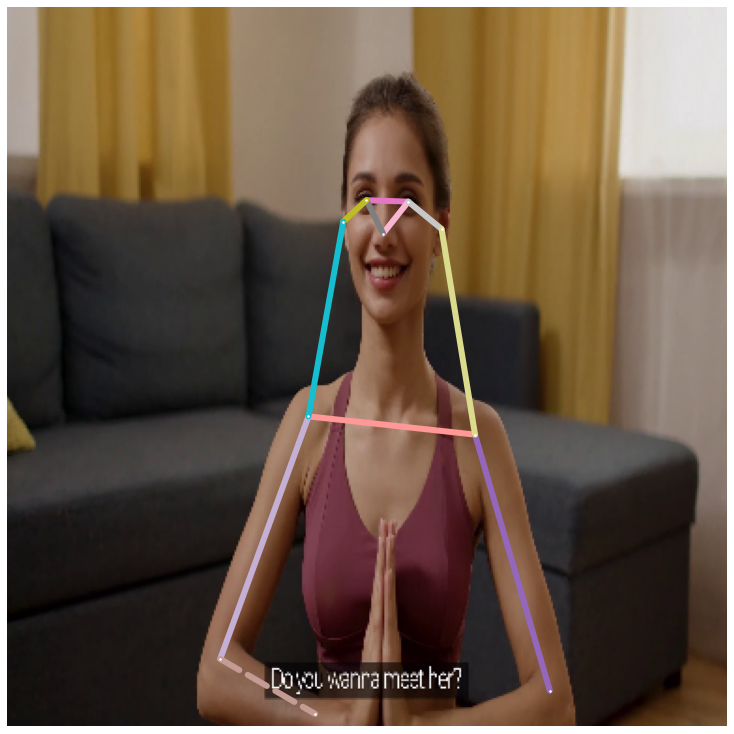

1416
PREDICTIONS NONE


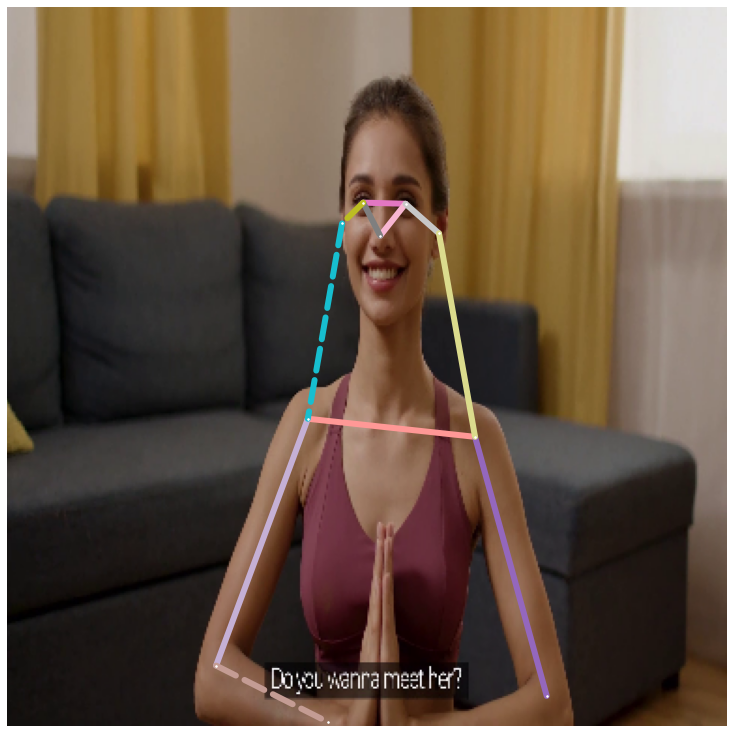

1419
PREDICTIONS NONE


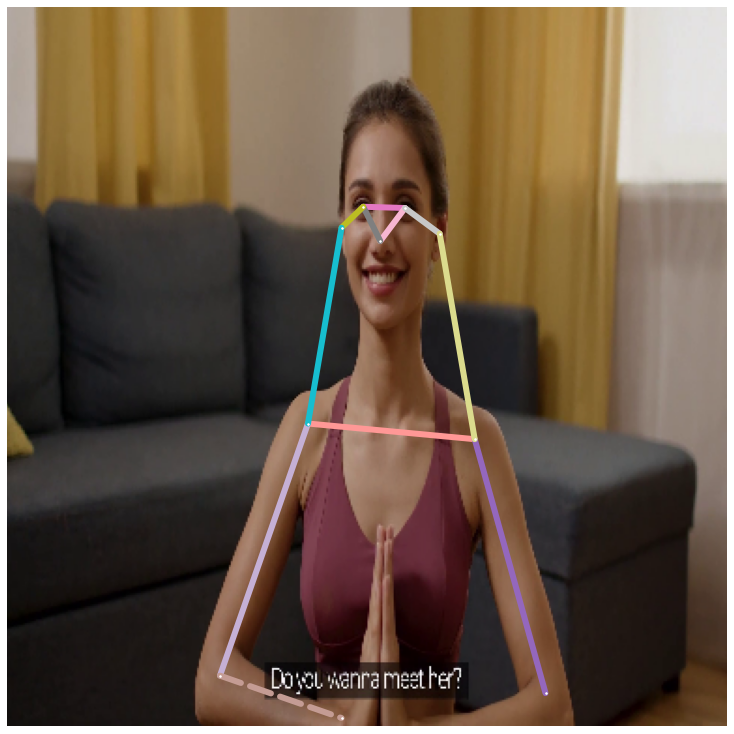

1422
PREDICTIONS NONE


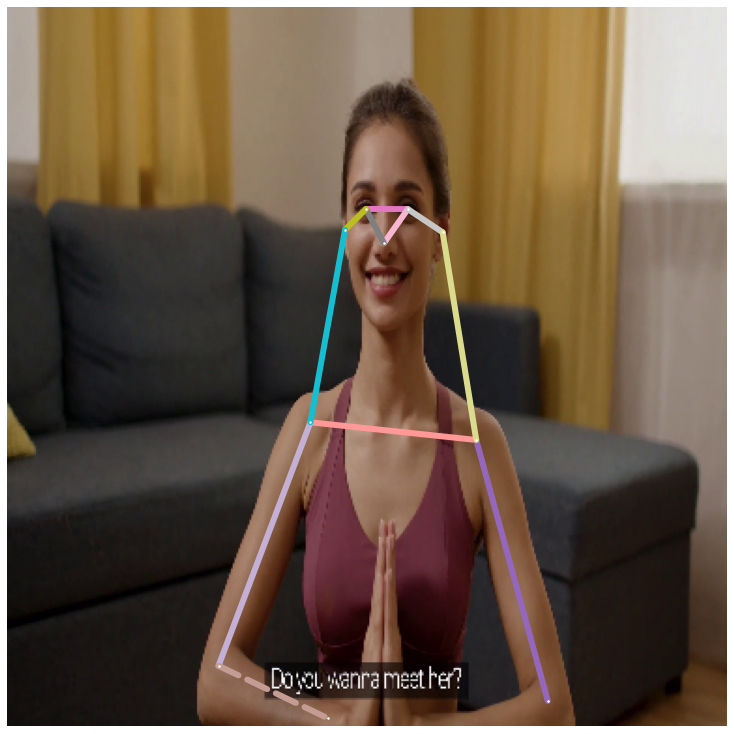

1425
PREDICTIONS NONE


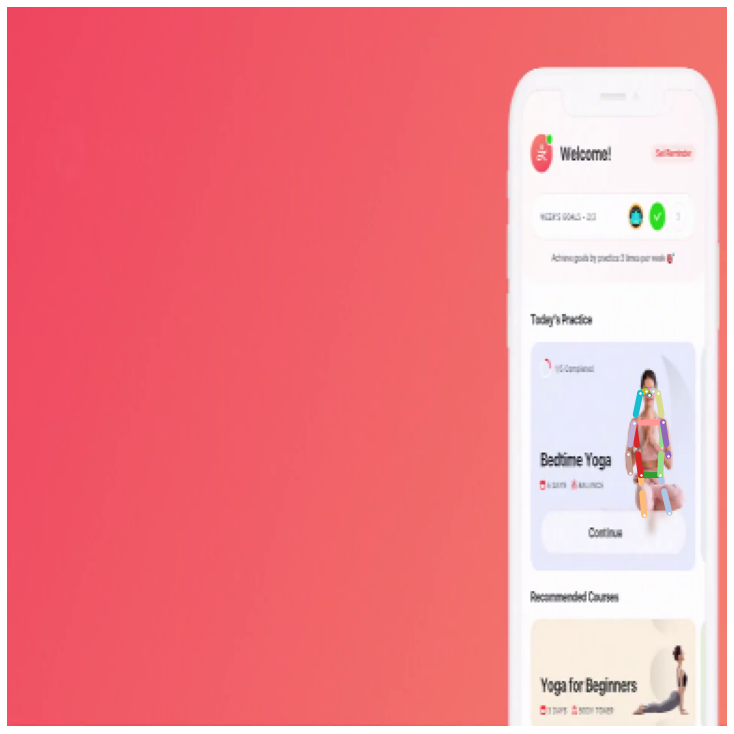

1428
PREDICTIONS NONE


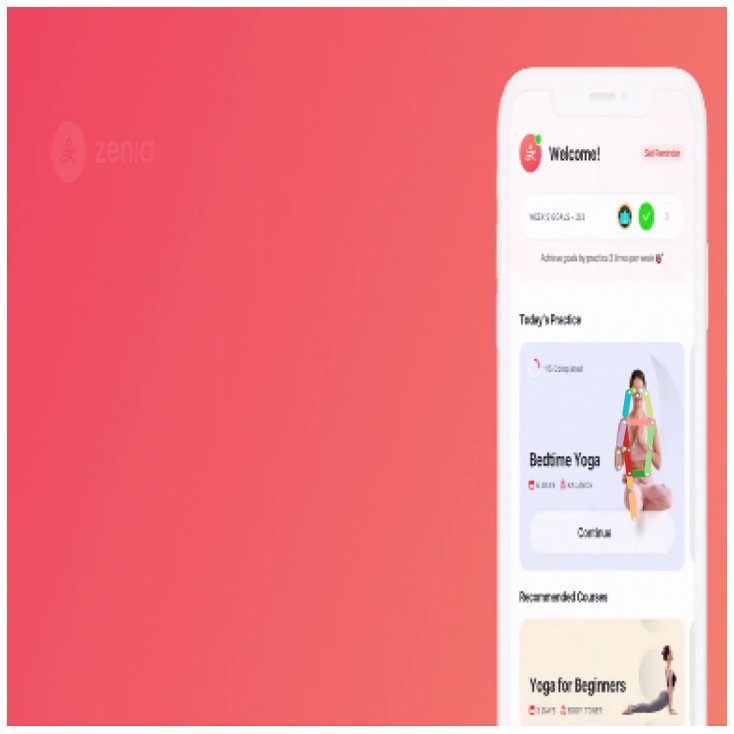

1431
PREDICTIONS NONE


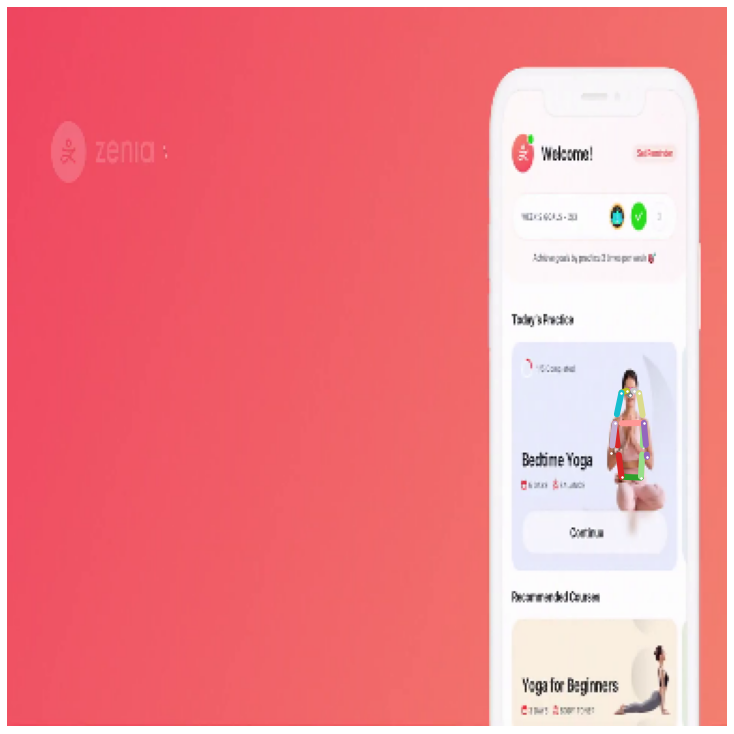

1434
PREDICTIONS NONE


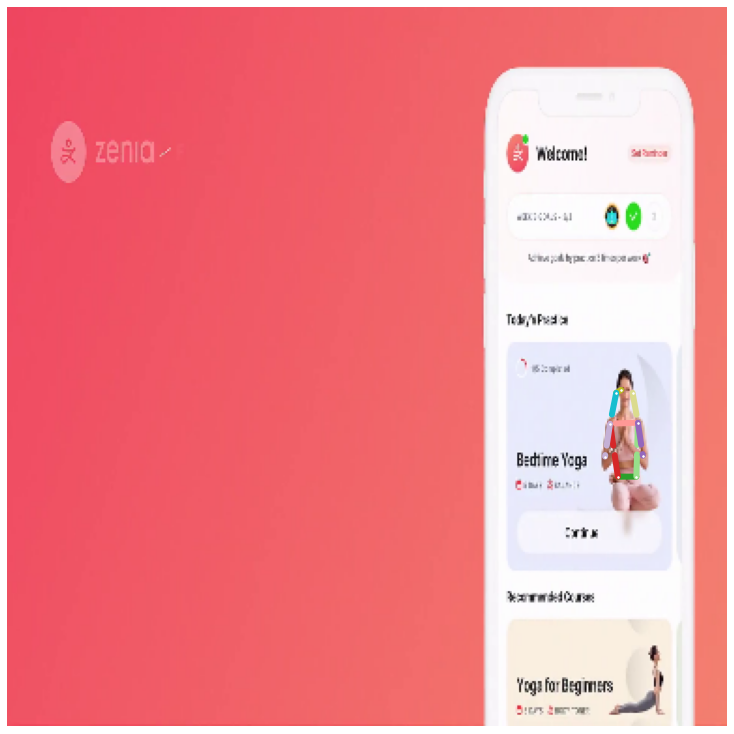

1437
PREDICTIONS NONE


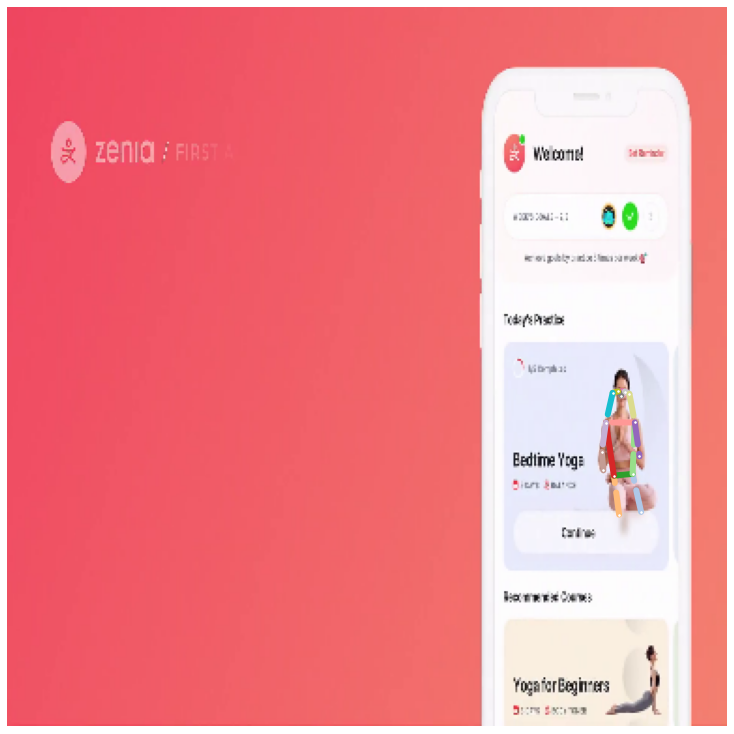

1440
PREDICTIONS NONE


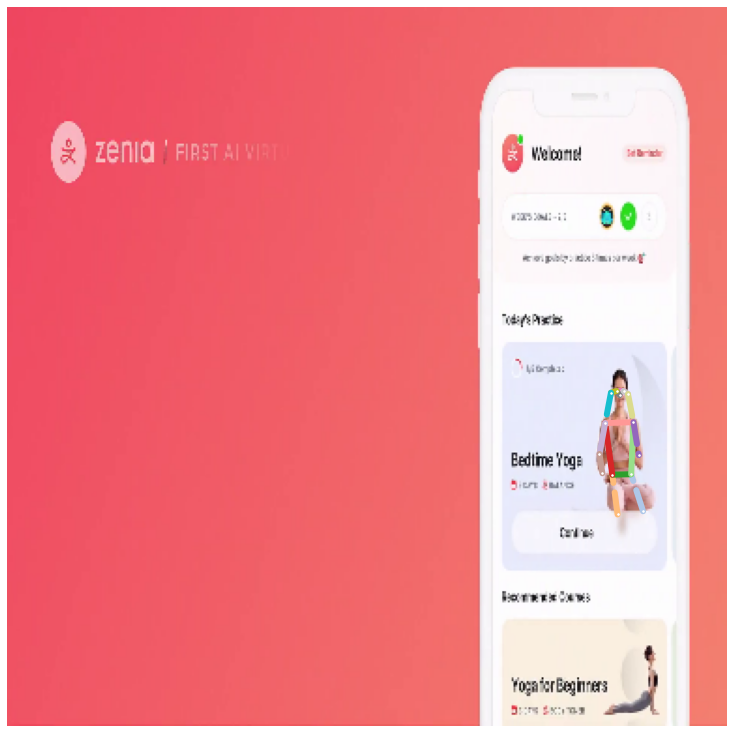

1443
PREDICTIONS NONE


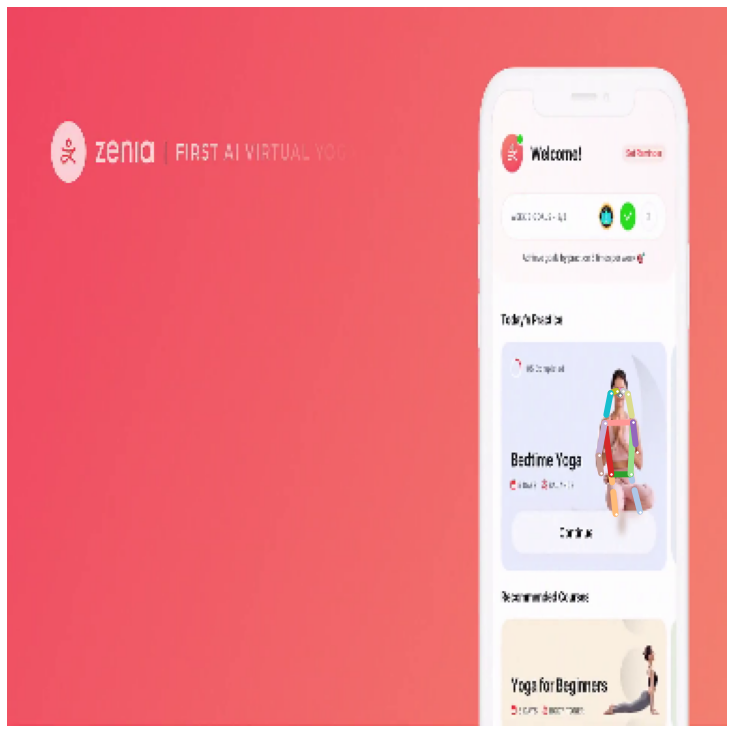

1446
PREDICTIONS NONE


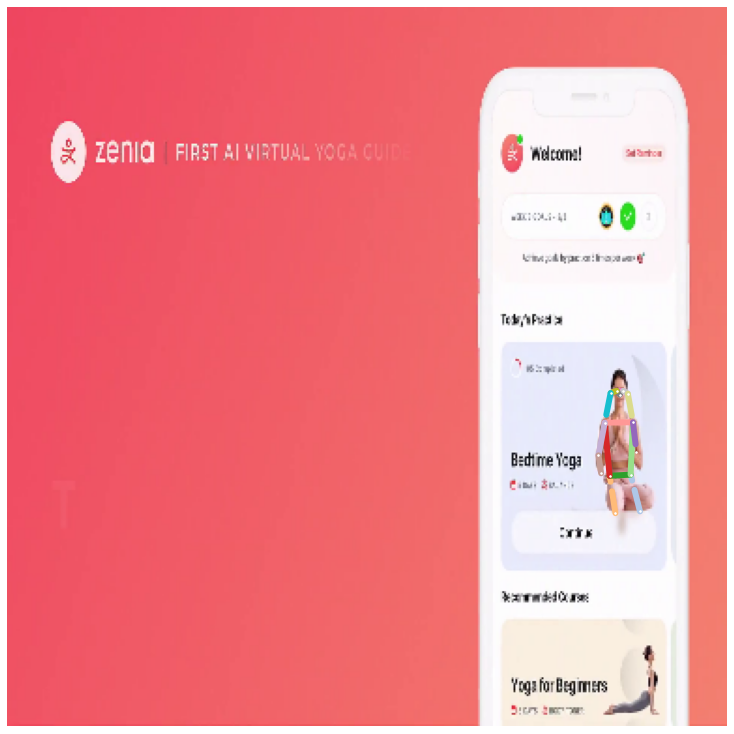

1449
PREDICTIONS NONE


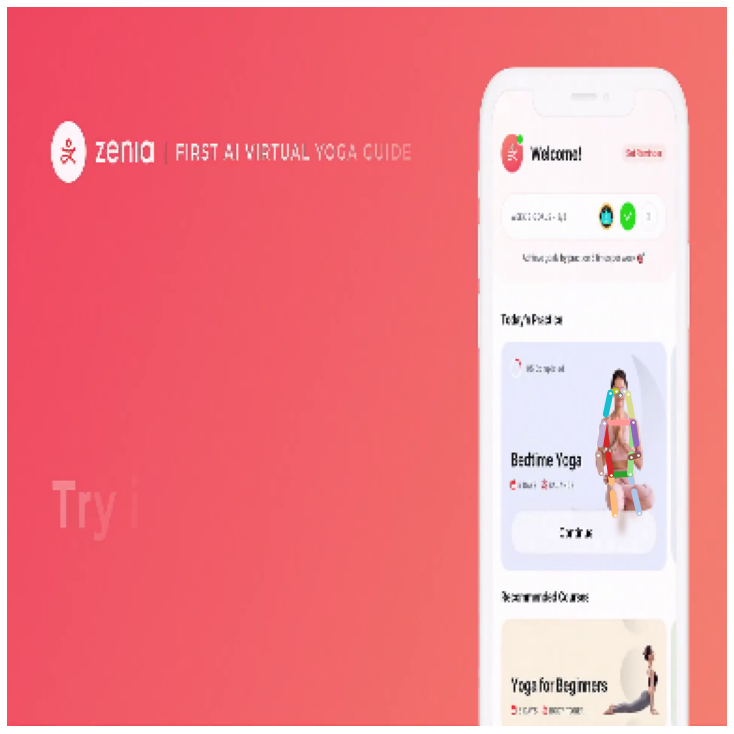

1452
PREDICTIONS NONE


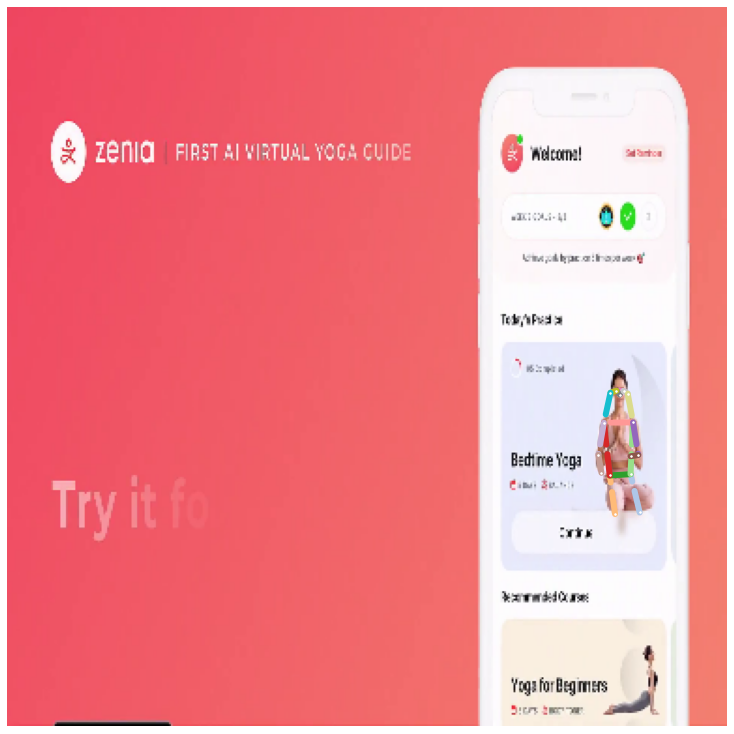

1455
PREDICTIONS NONE


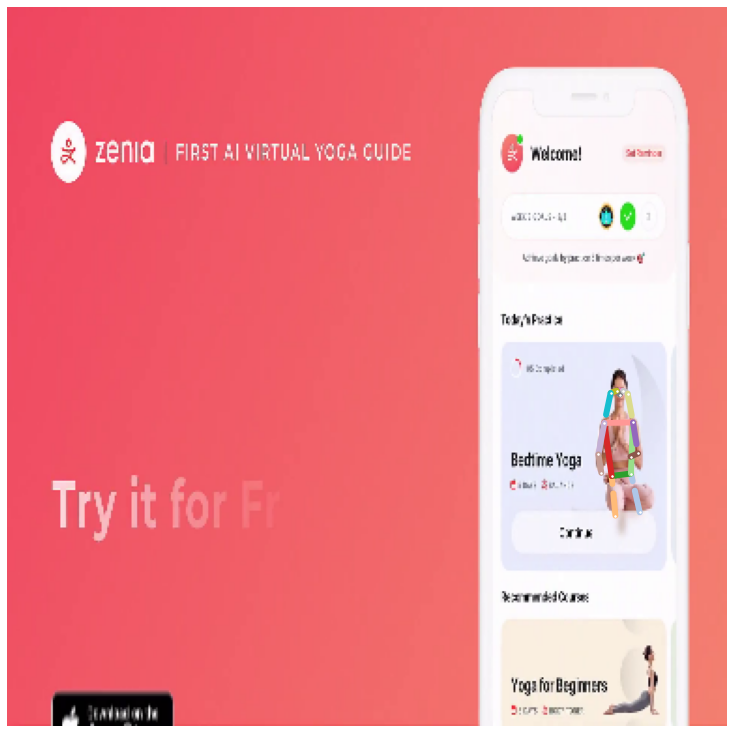

1458
PREDICTIONS NONE


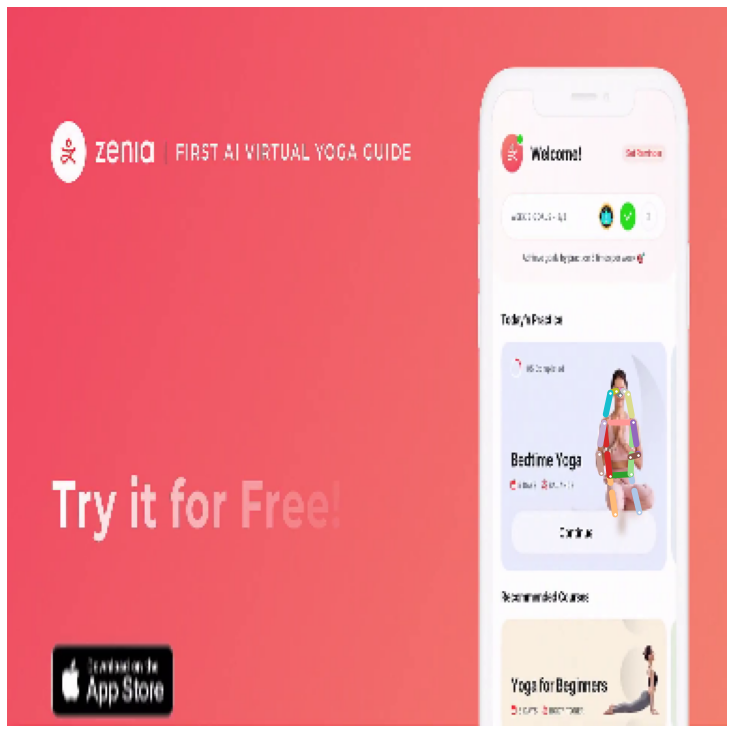

1461
PREDICTIONS NONE


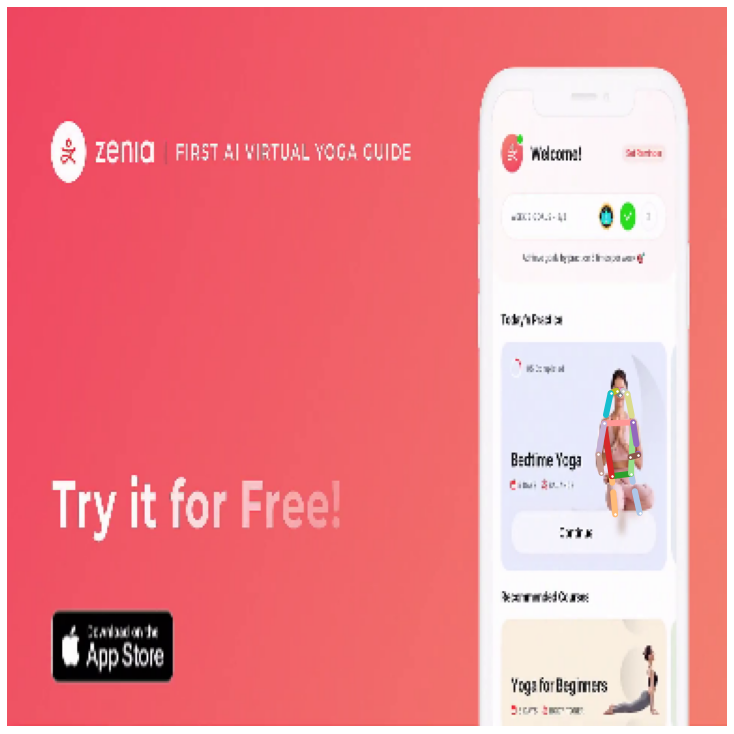

1464
PREDICTIONS NONE


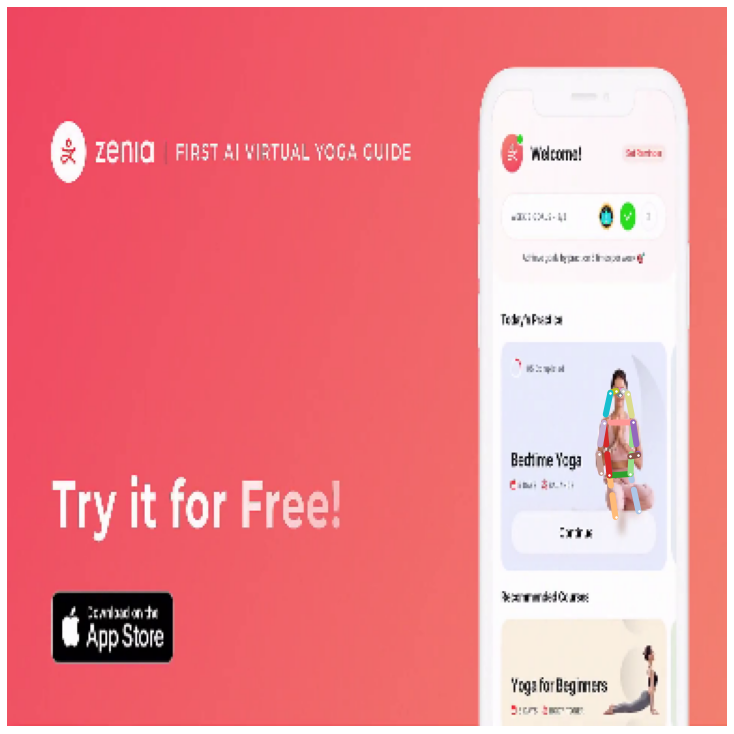

1467
PREDICTIONS NONE


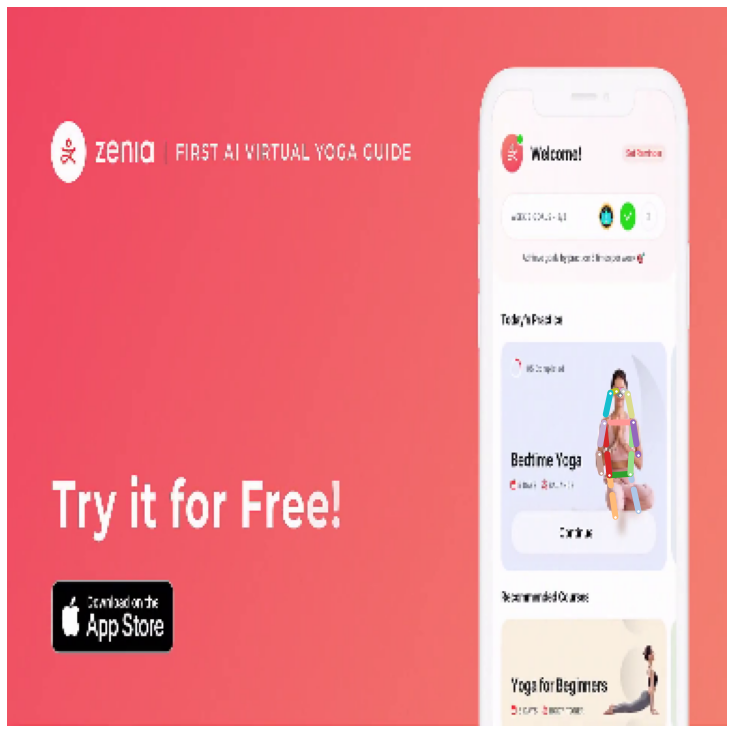

1470
PREDICTIONS NONE


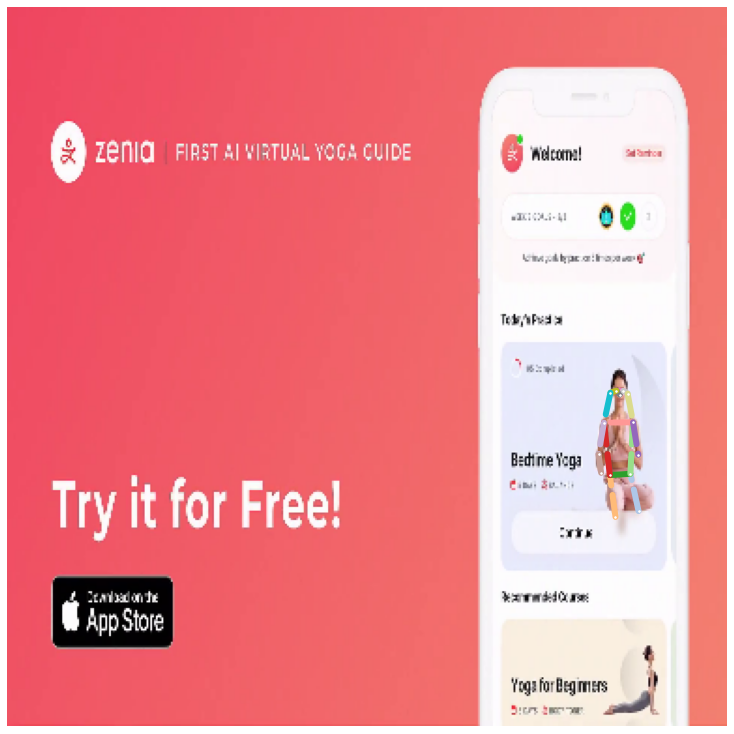

1473
PREDICTIONS NONE


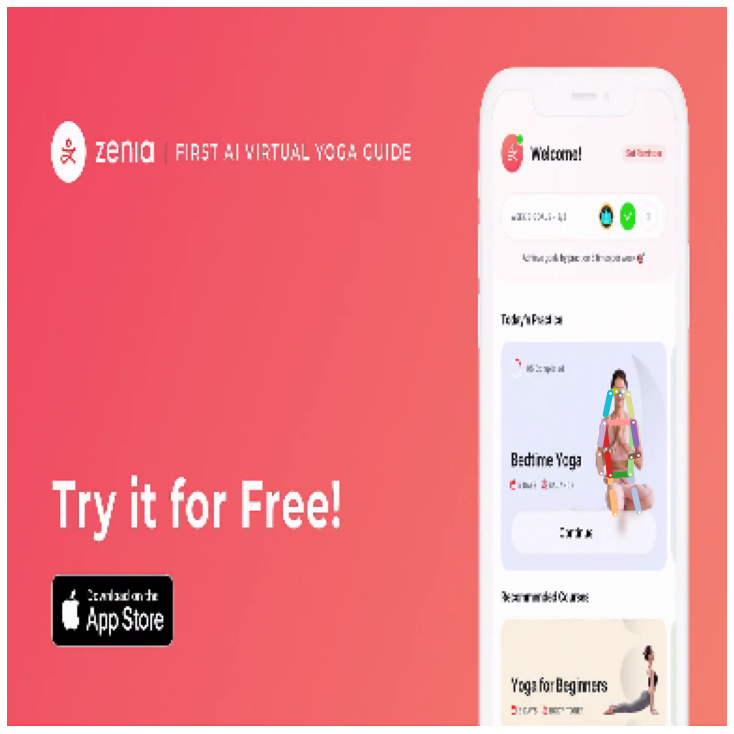

1476
PREDICTIONS NONE


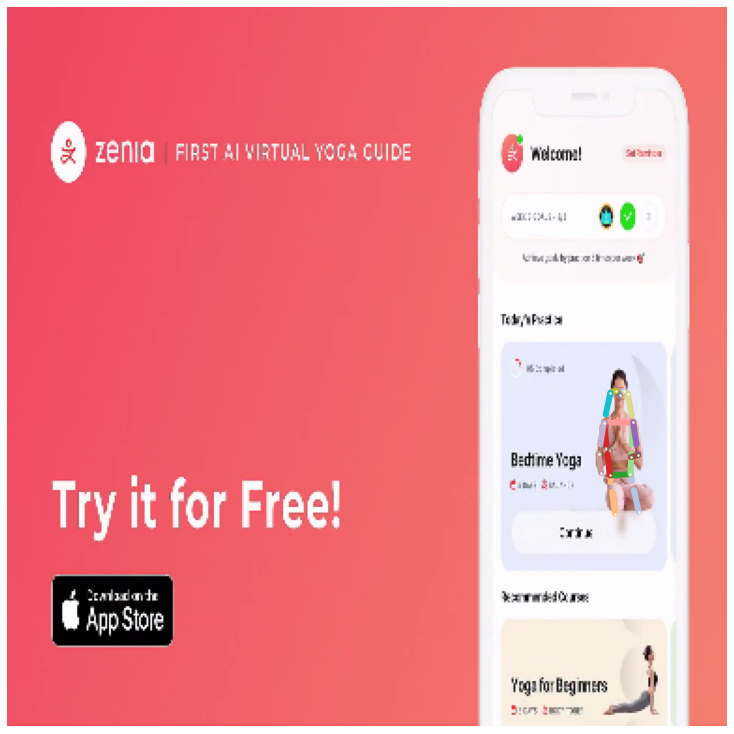

1479
PREDICTIONS NONE


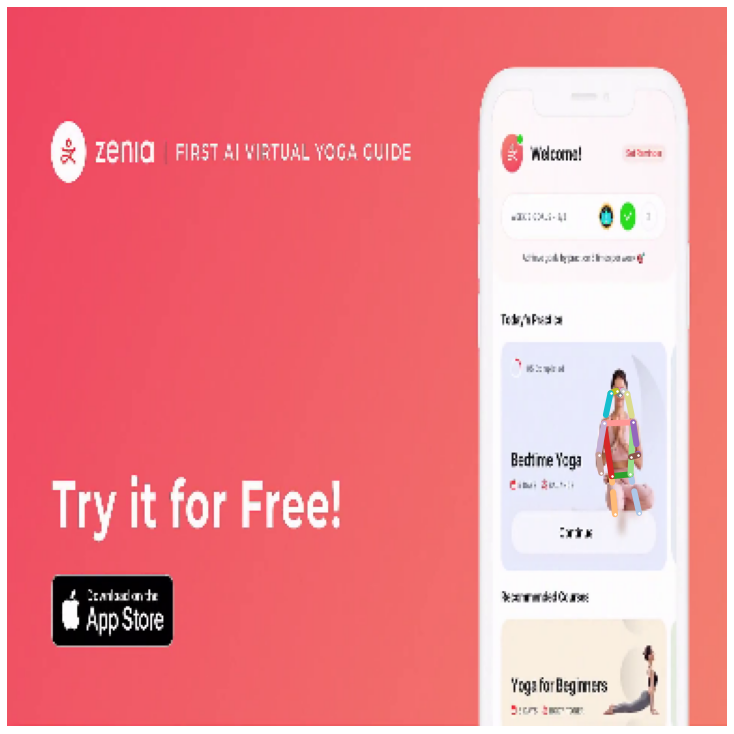

1482
PREDICTIONS NONE


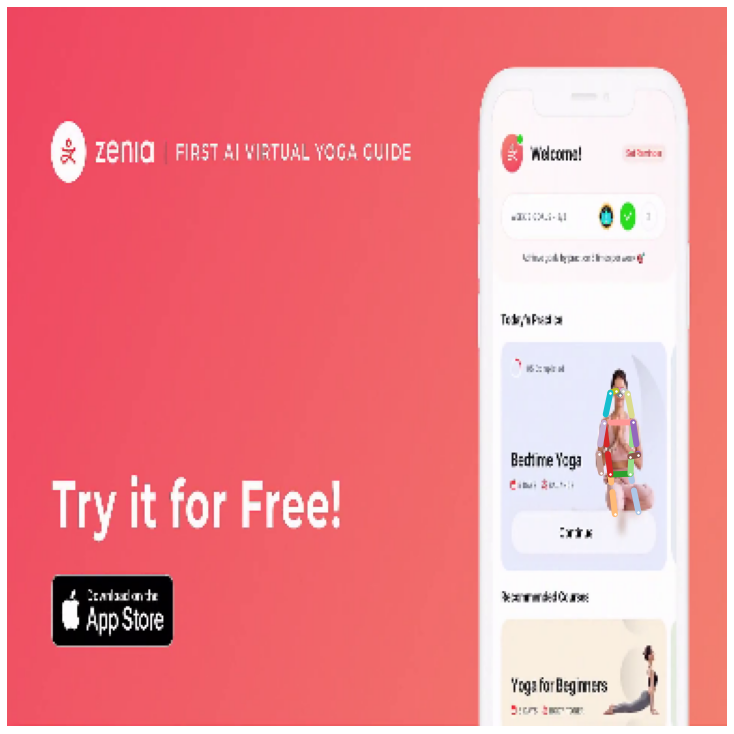

1485
PREDICTIONS NONE


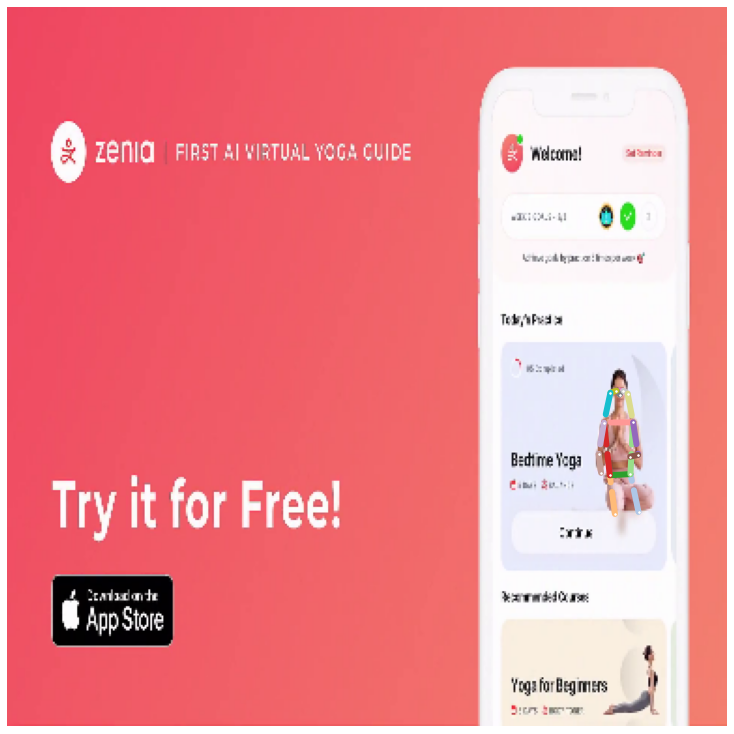

1488
PREDICTIONS NONE


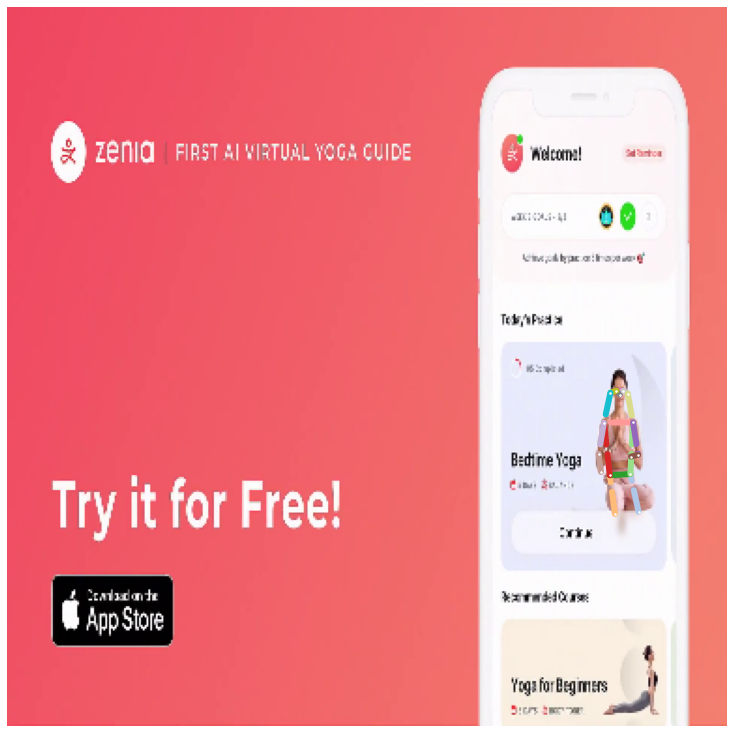

1491
PREDICTIONS NONE


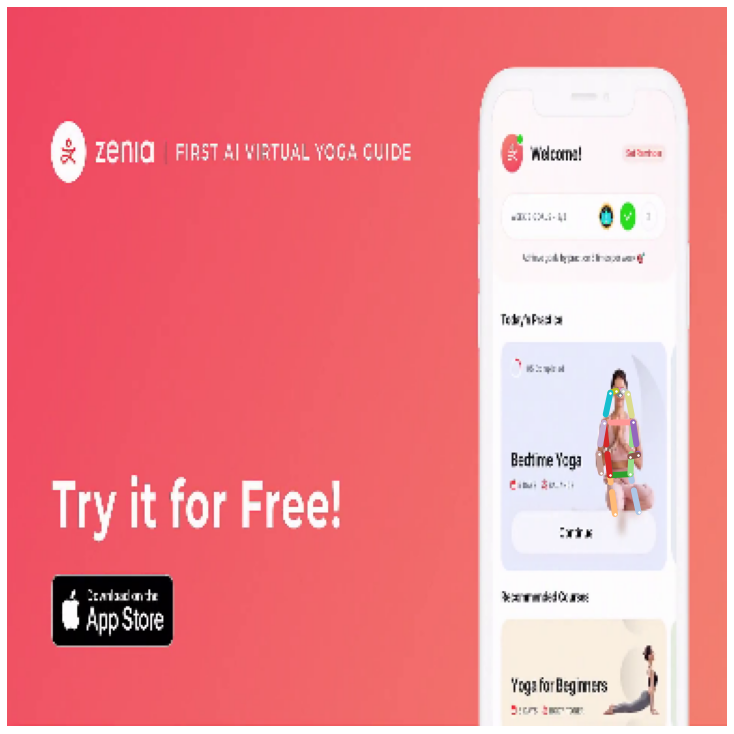

1494
PREDICTIONS NONE


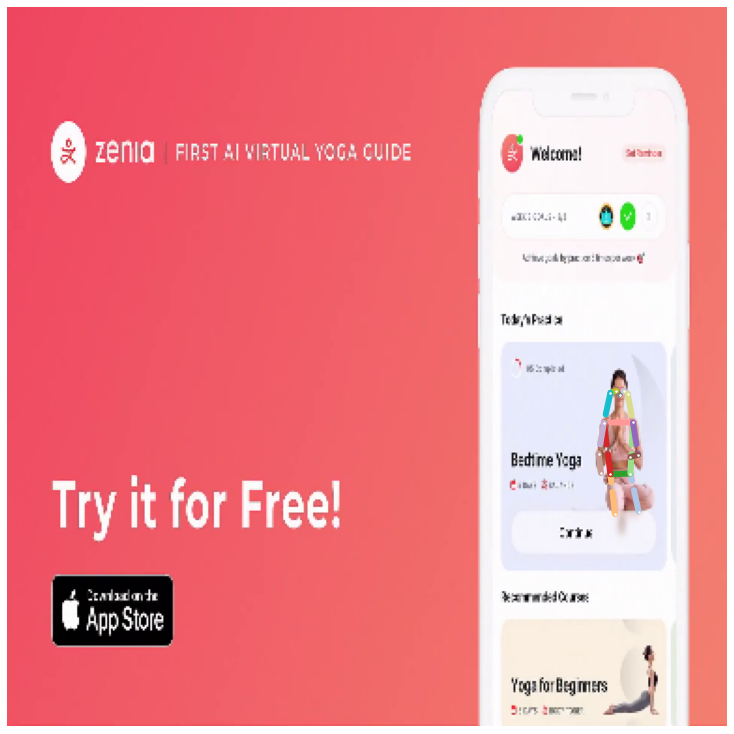

1497
PREDICTIONS NONE


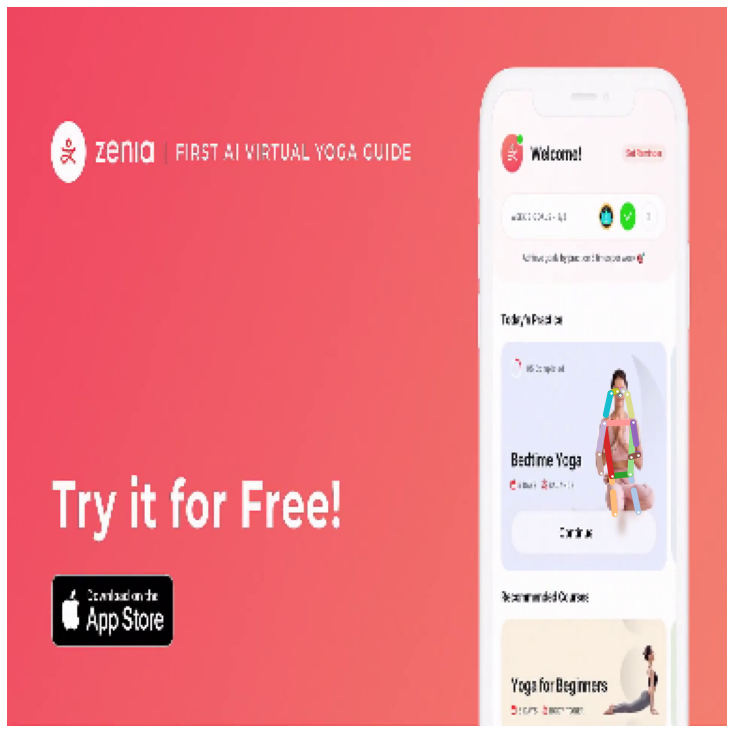

1500


error: OpenCV(4.1.2) /io/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [9]:
while(cap.isOpened()):
    ret, frame = cap.read()
    frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB) 
    ori = frame.copy()
#     ori = cv2.resize(ori, (int(ori.shape[1]/3), int(ori.shape[0]/3)))
    if ret == True:
        CURRENT_FRAME = CURRENT_FRAME + 1
        if CURRENT_FRAME%3==0 and CURRENT_FRAME>START_FRAME:
            frame = cv2.resize(frame, (385,385))
            frame = np.expand_dims(frame, axis=0)
            final  = model(frame.astype(np.float32),True)
            heads = [[],[]]
            heads[0] = final[0][0].numpy()
            heads[1] = final[1][0].numpy()

            predictions = []
            print("PREDICTIONS NONE")
            predictions = decoder.decode(heads)

            with image_canvas(frame[0]) as ax:
                keypoint_painter.annotations(ax, predictions)
                ax.figure.savefig('Temp_Images/test'+str(CURRENT_FRAME)+'.png')
            print(CURRENT_FRAME)
        else:
            continue
    else:
        continue



cap.release()
cv2.destroyAllWindows()

In [12]:
plt.imshow(frame[0])

TypeError: 'NoneType' object is not subscriptable

In [ ]:
len( os.listdir('Temp_Images'))

In [13]:
ls ..


Flatbuffer_Models/  Notebooks/  TFLite_Models/  __pycache__/
Models/             Scripts/    Test/


In [ ]:
ori.shape

In [14]:
import cv2
import numpy as np
import glob
import matplotlib.pyplot as plt

In [ ]:
# ls Temp_Images/test

In [15]:
OUTPUT_NAME = 'dost.mp4'
FRAME_RATE = 15

# CURRENT_FRAME = 20097
START_FRAME = 0

files =[]
for i in range(START_FRAME+1,CURRENT_FRAME,3):
    files.append('Temp_Images/test'+str(i)+'.png')

In [16]:
files[0]

'Temp_Images/test1203.png'

TypeError: Image data of dtype object cannot be converted to float

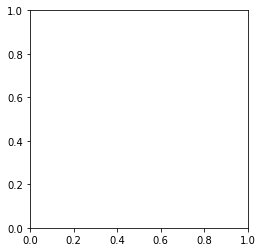

In [17]:
plt.imshow(cv2.imread(files[-1]))

In [ ]:
img_array = []
for filename in files:
    try:
        print(filename)
        img = cv2.imread(filename)
#         img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        height, width, layers = img.shape
        size = (width,height)
        img_array.append(img)
    except:
        y = 0
print(len(img_array))

In [ ]:
out = cv2.VideoWriter('testt.mp4',cv2.VideoWriter_fourcc(*'DIVX'), 7, (width,height))

In [ ]:
img_array[0].shape

In [ ]:
plt.imshow(img_array[0])

In [ ]:
for i in range(len(img_array)):
    print(i)
    try:
        out.write(img_array[i])
    except:
        print("ji")
out.release()

In [ ]:
pwd

## tflite conversion

In [ ]:
pifpaf7.summary()

In [ ]:
pifpaf7.save('Models/Original_Models/Shufflenet/')

In [ ]:
!tflite_convert \
  --saved_model_dir=Models/Original_Models/Shufflenet/ \
  --output_file=TFLite_Models/shufflenet.tflite

## TFLITE Inference

### Initializing TFLite Model

In [ ]:
interpreter = tf.lite.Interpreter(model_path="TFLite_Models/shufflenet.tflite")
interpreter.allocate_tensors()

# Get input and output tensors.
input_details = interpreter.get_input_details()
output_details = interpreter.get_output_details()

### Test Data Using image Link

In [ ]:
IMAGE_LINK = 'https://www.telegraph.co.uk/content/dam/football/2017/03/08/JS122863774_Getty-Images-Europe_FC-Barcelona-v-Paris-Saint-Germain-UEFA-Champions-League-Round_trans_NvBQzQNjv4BqqVzuuqpFlyLIwiB6NTmJwZ_d2gJnLGFVBaEhcbHfaHk.jpg?imwidth=450'
image_response = requests.get(IMAGE_LINK)
pil_im = PIL.Image.open(io.BytesIO(image_response.content)).convert('RGB')
pil_im = pil_im.resize((385,385))
im = np.asarray(pil_im)
data1=np.expand_dims(im,axis=0).astype(np.float32)

### Test Data Using Local Image

In [ ]:
# IMAGE_PATH = 'input_image.jpg'
# pil_im = PIL.Image.open(IMAGE_PATH)
# pil_im = pil_im.resize((385,385))
# im = np.asarray(pil_im)
# data1=np.expand_dims(im,axis=0).astype(np.float32)

### Allocating Tensors

In [ ]:
interpreter.set_tensor(input_details[0]['index'], data1)

### Running Model

In [ ]:
interpreter.invoke()

### Extracting Output

In [ ]:
final1 = interpreter.get_tensor(output_details[0]['index'])
final2 = interpreter.get_tensor(output_details[1]['index'])

### Calculating Pose

In [ ]:
heads = [[],[]]
heads[0] = final1[0]
heads[1] = final2[0]

from Decoder import CifCaf, KeypointPainter, image_canvas

keypoint_painter = KeypointPainter(color_connections=True, linewidth=6)

predictions = []

keypoints = ['nose', 'left_eye', 'right_eye', 'left_ear', 'right_ear', 'left_shoulder', 'right_shoulder', 'left_elbow', 'right_elbow', 'left_wrist',
             'right_wrist', 'left_hip', 'right_hip', 'left_knee', 'right_knee', 'left_ankle', 'right_ankle']
skeleton = [(16, 14), (14, 12), (17, 15), (15, 13), (12, 13), (6, 12), (7, 13), (6, 7), (6, 8), (7, 9), (8, 10), (9, 11), (2, 3), (1, 2), (1, 3), (2, 4),
             (3, 5), (4, 6), (5, 7)]

decoder = CifCaf(keypoints=keypoints,skeleton=skeleton)
predictions = decoder.decode(heads)



### Plotting Results

In [ ]:
with image_canvas(data1[0]/255) as ax:
    keypoint_painter.annotations(ax, predictions)
#     ax.figure.savefig('output.png')
print(" Image saved as output.png in current directory ")

## Flatbuffer

In [ ]:
!xxd -i ../TFLite_Models/shufflenet.tflite > ../Flatbuffer_Models/shufflenet.cc